In [18]:
import os
os.environ['MKL_VERBOSE'] = '0'
import pybinding as pb
import numpy as np
import matplotlib.pyplot as plt
from math import sqrt, pi
from scipy.stats import wasserstein_distance
pb.pltutils.use_style()
import torch


In [19]:
#Creating a triangular polygon 

from math import sqrt
def triangle_rot(a,b,c,shx,shy):
    return pb.Polygon([[shx,-a/2+shy], [shx,b/2+shy], [c+shx,shy]])


In [20]:
#Kagome lattice with a Hamiltonian that has more free model-parameters 
def Kagome_lattice(d, t_a=-1,t_b=-1,t_nnn=0,v_a=0,v_b=0,v_c=0):   # more parameters of kagome lattice
    a_cc = d # near-neighbor distance in the lattice
    a=a_cc*2
    lat = pb.Lattice(a1=[a*sqrt(3)/2, -a/2],
                     a2=[a*sqrt(3)/2, a/2])
    lat.add_sublattices(('A',[a*sqrt(3)/4,-a/4],v_a),('B',[a*sqrt(3)/4,a/4],v_b),('C', [0, 0],v_c))
    lat.add_hoppings(([0,0],'A','C',t_a),
                     ([1,0],'A','C',t_b),
                     ([0,0],'B','A',t_a),
                     ([-1,1],'B','A',t_b),
                     ([0,0],'C','B',t_a),
                     ([0,-1],'C','B',t_b),
                     ([1,0],'A','B',t_nnn),
                     ([1,0],'B','C',t_nnn),
                     ([0,1],'B','A',t_nnn),
                     ([0,1],'A','C',t_nnn),
                     ([-1,1],'C','A',t_nnn),
                     ([-1,1],'B','C',t_nnn),
                    )
    return lat

**The next code block needs to be changed to create the lattice of choice**

In [21]:
#Take the shape and hamiltonian parameters as input and return the model
def lattice_model(d, t_a=-1,t_b=-1,t_nnn=0,v_a=0,v_b=0,v_c=0,plot_figure=False):
    shape = triangle_rot(1.3,1.3,1.15,.10,d)  # adjusted which works for d=0.133
    model = pb.Model(Kagome_lattice(d,t_a,t_b,t_nnn,v_a,v_b,v_c),shape)
    if plot_figure:
        model.plot()
        shape.plot()
    return model



In [22]:
def DOS_value(model, start=-0.15, stop=0.25, number=200, broadening=0.003,plot_figure=False):
    solver = pb.solver.lapack(model)
    dos = solver.calc_dos(energies=np.linspace(start, stop, number), broadening=broadening)    # broadening is the smoothing parameter
    if plot_figure:
        dos.plot()
    return dos

In [23]:
def LDOS_value(model, energy=-0.08, broadening=0.003,plot_figure=False):
    solver = pb.solver.lapack(model)
    ldos_map = solver.calc_spatial_ldos(energy, broadening)
    if plot_figure:
        plt.title("E = {} eV".format(energy))
        ldos_map.plot()
        pb.pltutils.colorbar(label="LDOS")
    return ldos_map

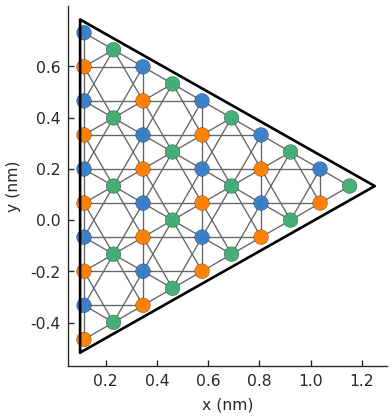

In [24]:
# Target Model
model_target = lattice_model(d=0.133,t_a=0.0285,t_b=0.075, plot_figure=True)


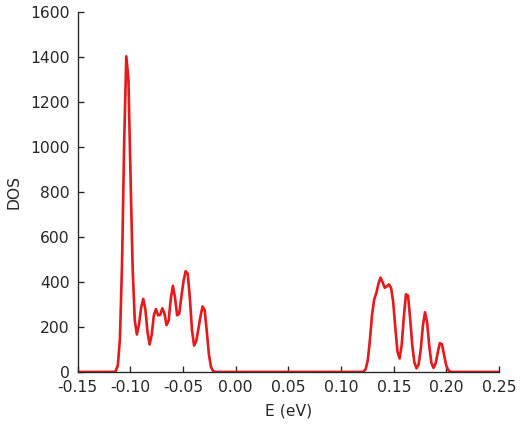

In [25]:
DOS_target = DOS_value(model_target,plot_figure=True)


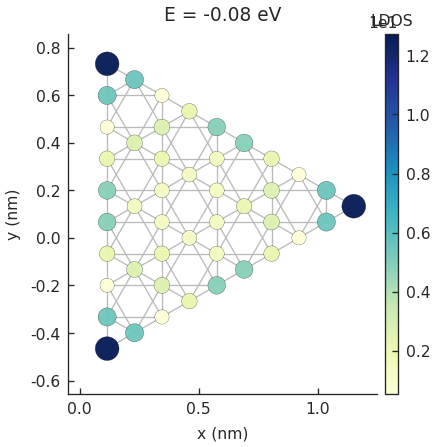

In [26]:

LDOS_target = LDOS_value(model_target,plot_figure=True)

In [27]:
# LDOS Error Function
def LDOS_squared_error(LDOS_target, LDOS_current):
    print(f"LDOS Current: {LDOS_current.data}\n")
    return np.sum((LDOS_target.data - LDOS_current.data)**2)

    

In [28]:
# DOS error function
# Return the wasserstein distance between two DOS
def DOS_Wasserstein_distance(DOS_target, DOS_current):
    print(f"DOS Current: {DOS_current.data}\n")
    return wasserstein_distance(DOS_target.data, DOS_current.data)

In [29]:
def multi_objective_error(model_current, LDOS_target, DOS_target, number_of_objectives=2):
    errors = []
    # Calculate LDOS of the current model
    LDOS_current = LDOS_value(model_current)
    LDOS_error = LDOS_squared_error(LDOS_target, LDOS_current)
    LDOS_error = -LDOS_error
    errors.append(LDOS_error)
    
    if number_of_objectives > 1:
        # Calculate DOS of the current model
        DOS_current = DOS_value(model_current)
        DOS_error = DOS_Wasserstein_distance(DOS_target, DOS_current)
        DOS_error = -DOS_error
        errors.append(DOS_error)
    
    return torch.tensor(errors)

In [30]:
def compute_train_obj(train_x, LDOS_target, DOS_target, number_of_objectives=2):
    train_obj = []
    for input_x in train_x:
        model_current = lattice_model(
            d=0.133,
            t_a=input_x[0].item(),
            t_b=input_x[1].item(),
            t_nnn=input_x[2].item(),
            v_a=input_x[3].item(),
            v_b=input_x[4].item(),
            v_c=input_x[5].item()
        )
        # Calculate the error
        errors = multi_objective_error(model_current, LDOS_target, DOS_target, number_of_objectives)
        train_obj.append(errors)
    # Stack the list of errors
    train_obj = torch.stack(train_obj)
    return train_obj
    

In [31]:

tkwargs = {
    "dtype": torch.double,
    "device": torch.device("cuda" if torch.cuda.is_available() else "cpu"),
}
SMOKE_TEST = os.environ.get("SMOKE_TEST")

**Define the design space**

Let us fix the d -  modify t_a, t_b , t_nnn, v_a, v_b, v_c

Modify it in a range of -1.5 to 1.5 at 0.2 intervals


In [32]:
dimension = 6
lower_bound = torch.tensor([-1.5, -1.5, -1.5, -1.5, -1.5, -1.5], **tkwargs)
upper_bound = torch.tensor([1.5, 1.5, 1.5, 1.5, 1.5, 1.5], **tkwargs)
least_count = torch.tensor([0.2, 0.2, 0.2, 0.2, 0.2, 0.2], **tkwargs)

In [33]:
from botorch.models import SingleTaskGP
from botorch.models.model_list_gp_regression import ModelListGP
from botorch.models.transforms.outcome import Standardize
from gpytorch.mlls.sum_marginal_log_likelihood import SumMarginalLogLikelihood
from botorch.utils.transforms import unnormalize, normalize
from botorch.utils.sampling import draw_sobol_samples

def generate_initial_data(n=5):
    # generate training data
    train_x = draw_sobol_samples(bounds=torch.stack([lower_bound, upper_bound]), n=n, q=1, seed=0).squeeze(1)
    train_obj = compute_train_obj(train_x, LDOS_target, DOS_target)
    return train_x, train_obj

generate_initial_data(5)


LDOS Current: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

DOS Current: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]

LDOS Current: [2.36546510e-27 1.29660123e-27 4.40001903e-28 2.81550959e-26
 4.78042197e-28 1.41994397e-28 2.79496451e-25 1.00404747e-27
 3.75003019e-27 1.04296338e-27 1.46641404e-27 4.52690635e-26
 1.08352655e-27 1.71906269

(tensor([[-0.0747,  0.2776, -0.0166, -0.5584,  1.3683, -1.2501],
         [ 0.3891, -0.1248,  1.0946,  1.3051, -1.1568,  0.4615],
         [ 1.0119,  1.1424, -1.1041, -0.9907, -0.3747,  1.2441],
         [-1.3266, -1.4584,  0.0260,  0.2395,  0.1119, -0.4675],
         [-0.8934,  1.0674,  1.1963,  0.4797,  0.5259, -1.0227]],
        dtype=torch.float64),
 tensor([[-915.0875, -111.9375],
         [-915.0875, -101.9875],
         [-915.0833, -101.9875],
         [-915.0875, -106.9625],
         [-915.0875, -111.9375]], dtype=torch.float64))

In [203]:
def initialize_model(train_x, train_obj):
    # define models for objective
    train_x = normalize(train_x, bounds=torch.stack([lower_bound, upper_bound]))
    models = []
    for i in range(train_obj.shape[-1]):
        train_y = train_obj[..., i:i+1]
        models.append(SingleTaskGP(train_x, train_y, outcome_transform=Standardize(m=1)
                                   )
                                   )
    model = ModelListGP(*models)
    mll = SumMarginalLogLikelihood(model.likelihood, model)
    return mll, model

# train_x, train_obj = generate_initial_data(5)
# mll, model = initialize_model(train_x, train_obj)

**Setup the acquisition function**

In [204]:
from botorch.optim.optimize import optimize_acqf, optimize_acqf_list
from botorch.acquisition.objective import GenericMCObjective
from botorch.utils.multi_objective.scalarization import get_chebyshev_scalarization
from botorch.utils.multi_objective.box_decompositions.non_dominated import (
    FastNondominatedPartitioning,)
from botorch.acquisition.multi_objective.monte_carlo import (
    qExpectedHypervolumeImprovement, qNoisyExpectedHypervolumeImprovement,)
from botorch.utils.sampling import sample_simplex

BATCH_SIZE = 4
NUM_RESTARTS = 10 if not SMOKE_TEST else 2
RAW_SAMPLES = 512 if not SMOKE_TEST else 4

standard_bounds = torch.zeros(2, dimension, **tkwargs)
standard_bounds[1] = 1.0
reference_point = None

def optimize_qehvi_and_get_observation(model, train_x, train_obj, sampler):

    global reference_point
    "Optimize qEHVI and get a new observation"
    # partition the objectives
    with torch.no_grad():
        pred = model.posterior(normalize(train_x, bounds=torch.stack([lower_bound, upper_bound]))).mean

    # Compute the reference point as slightly worse than the worst observed value
    if reference_point is None:
        reference_point = train_obj.min(dim=0).values
    

    partitioning = FastNondominatedPartitioning(ref_point=reference_point,
                                                Y=pred,)
    
    acq_func = qExpectedHypervolumeImprovement(
        model=model,
        ref_point=reference_point,
        partitioning=partitioning,
        sampler=sampler,
        )
    
    # optimize

    candidates, _ = optimize_acqf(
        acq_function=acq_func,
        bounds=standard_bounds,
        q=BATCH_SIZE,
        num_restarts=NUM_RESTARTS,
        raw_samples=RAW_SAMPLES,
        options={"batch_limit": 5, "maxiter": 200},
        sequential=True,
    )

    # observe new values
    new_x = unnormalize(candidates.detach(), bounds=torch.stack([lower_bound, upper_bound]))
    new_obj = compute_train_obj(new_x, LDOS_target, DOS_target)
    return new_x, new_obj

    




In [205]:
# Plotting the suggest points
def plot_train_obj(train_obj, new_objectives, iteration):
    plt.figure(figsize=(6,6))
    plt.scatter(train_obj[:,0].cpu(), train_obj[:,1].cpu(), color="red", label='Train Objectives')
    plt.scatter(new_objectives[:,0].cpu(), new_objectives[:,1].cpu(), color="blue", label='New Objectives')
    plt.xlabel('LDOS error')
    plt.ylabel('DOS error')
    plt.title(f'Iteration {iteration}')
    plt.grid(True)
    plt.show()


**Perform Bayesian Optimization**


Next Point: tensor([[ 1.5000,  0.1226,  1.5000,  0.0586,  0.0837,  0.4240],
        [ 1.4877,  0.1944,  1.5000, -0.1137,  0.2823,  1.1039],
        [ 1.4833,  0.3890,  1.5000, -0.4361,  0.6605,  0.3274],
        [ 1.3479, -0.4871,  1.4824,  0.2040, -0.1500,  0.4917]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875,  -87.0626],
        [-915.0875, -101.2556],
        [-914.2338, -101.9875],
        [-915.0875,  -99.5000]], dtype=torch.float64)


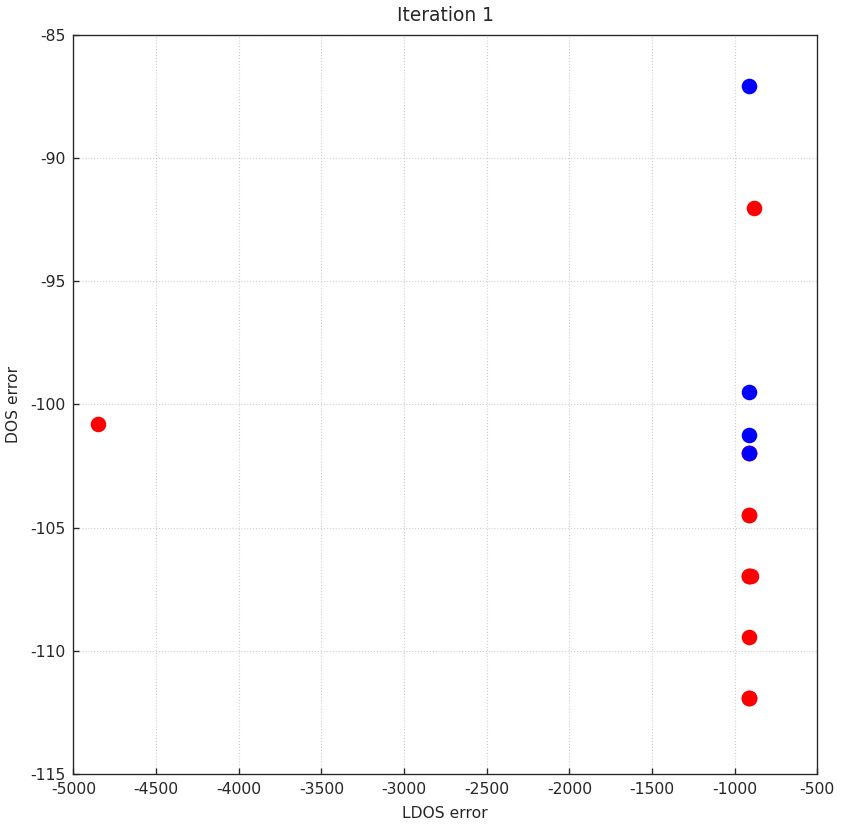


Batch  1: Hypervolume (qEHVI) = (98514.08) time = 8.15.
Next Point: tensor([[ 1.5000,  0.2026,  1.0702,  0.1966,  0.0061,  0.3432],
        [ 0.9228,  0.1899,  1.5000,  0.0163, -0.0228,  0.3449],
        [ 1.5000,  0.0842,  1.5000, -0.2806, -0.0874,  0.3347],
        [ 1.4637,  0.1676,  1.5000,  0.5609,  0.1758,  0.4109]],
       dtype=torch.float64)

Next Objective: tensor([[ -915.0875,  -104.4750],
        [ -915.0875,  -101.9875],
        [-1578.9318,   -91.8287],
        [ -798.9148,   -94.6357]], dtype=torch.float64)


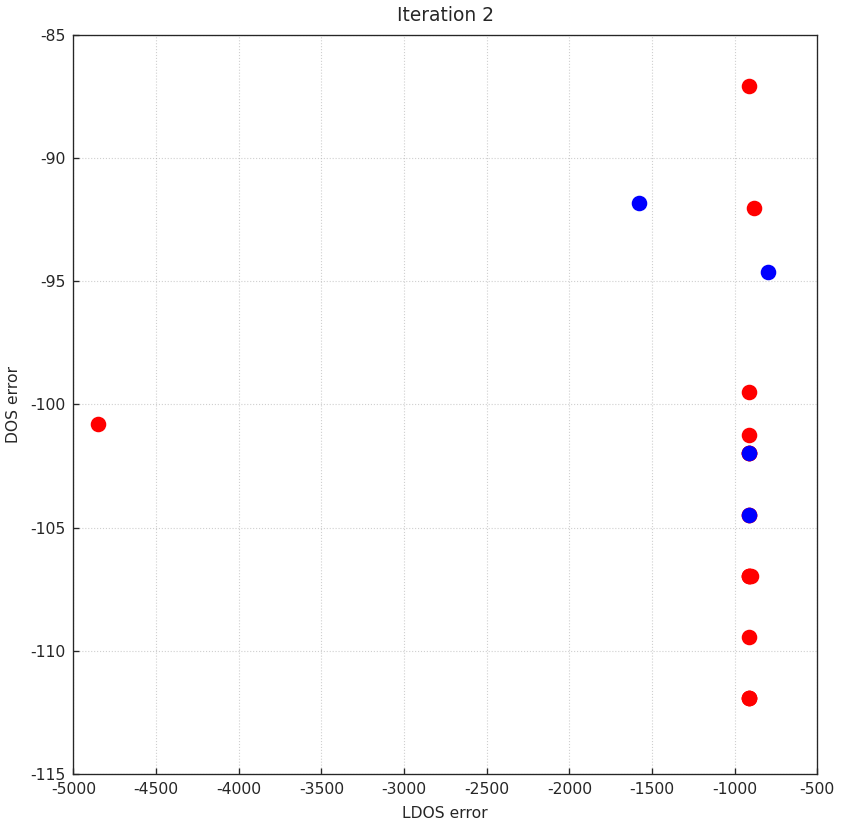


Batch  2: Hypervolume (qEHVI) = (99987.32) time = 8.97.
Next Point: tensor([[ 1.4887,  0.6095,  1.5000,  0.2452,  0.1905,  0.5140],
        [ 1.4581, -0.1194,  1.5000,  0.2659,  0.4348,  0.4768],
        [-1.1477,  1.2383, -0.7636,  1.5000, -0.4089,  0.5617],
        [ 1.5000,  0.1524,  1.5000,  0.0652,  0.0588,  0.4101]],
       dtype=torch.float64)

Next Objective: tensor([[-898.4981,  -97.0125],
        [-915.0875, -105.5096],
        [-915.0875, -106.9625],
        [-915.0875,  -87.0634]], dtype=torch.float64)


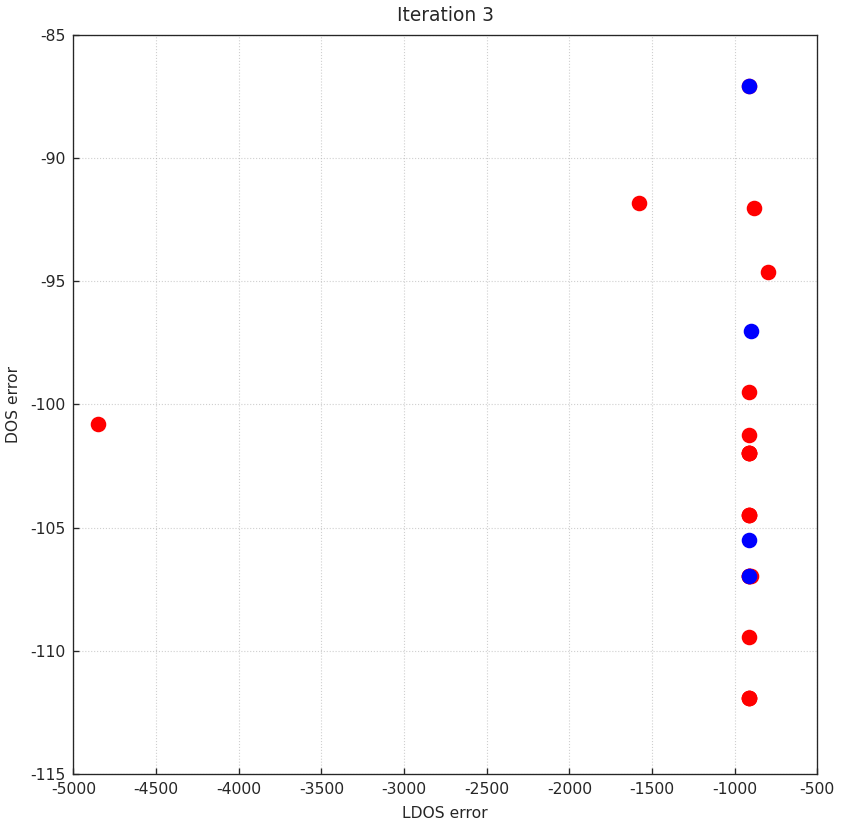


Batch  3: Hypervolume (qEHVI) = (99987.32) time = 9.57.
Next Point: tensor([[ 1.4915,  0.1247,  1.5000,  0.6361,  0.0103, -0.1205],
        [-1.1590, -1.3945,  0.0662, -0.0767,  0.6704,  0.2894],
        [ 1.4900,  0.0870,  1.5000,  0.3145,  0.0125,  0.6882],
        [-0.1907,  0.9334,  1.1975, -0.2955,  1.4333, -0.2184]],
       dtype=torch.float64)

Next Objective: tensor([[ -915.0875,   -89.5506],
        [-1378.3887,  -106.6314],
        [ -914.9978,   -99.5000],
        [ -915.0875,  -109.4500]], dtype=torch.float64)


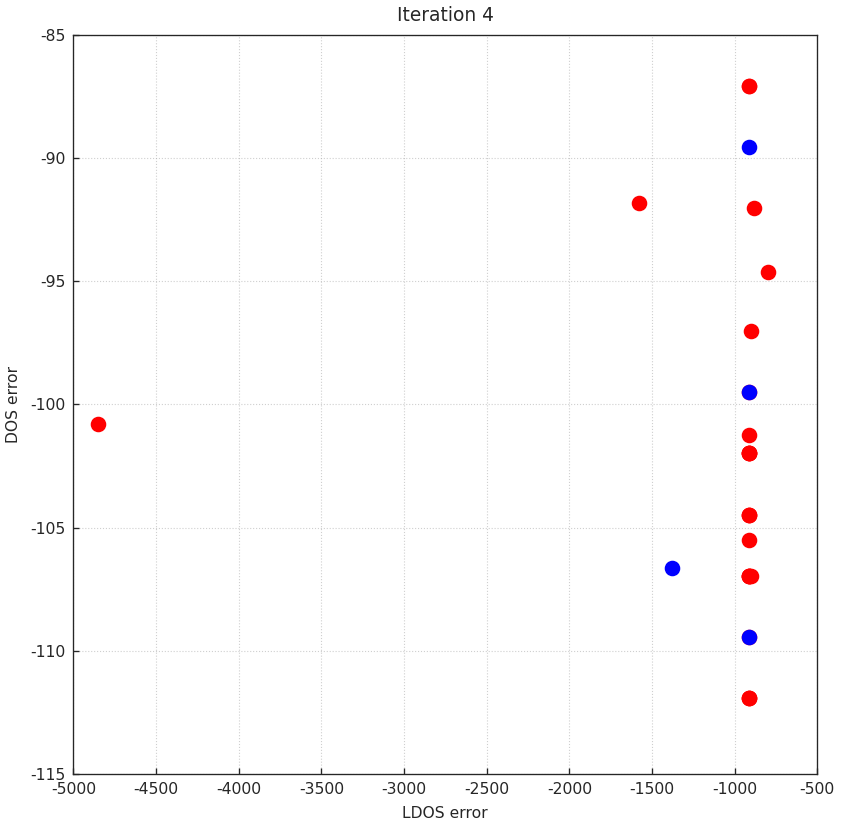


Batch  4: Hypervolume (qEHVI) = (99987.32) time = 6.98.
Next Point: tensor([[ 1.1597,  0.8217,  1.2275, -0.4806,  1.1702,  0.7979],
        [ 0.9579,  0.9209, -1.0938, -0.0830, -0.3453,  1.0460],
        [-0.5354,  0.5011,  1.5000,  0.7234, -0.0609,  0.2104],
        [ 0.5667,  0.3865, -0.7196, -1.0864,  0.8579, -0.1003]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -104.4750],
        [-915.0875, -102.5441],
        [-915.0875, -109.4500],
        [-759.5157,  -99.0357]], dtype=torch.float64)


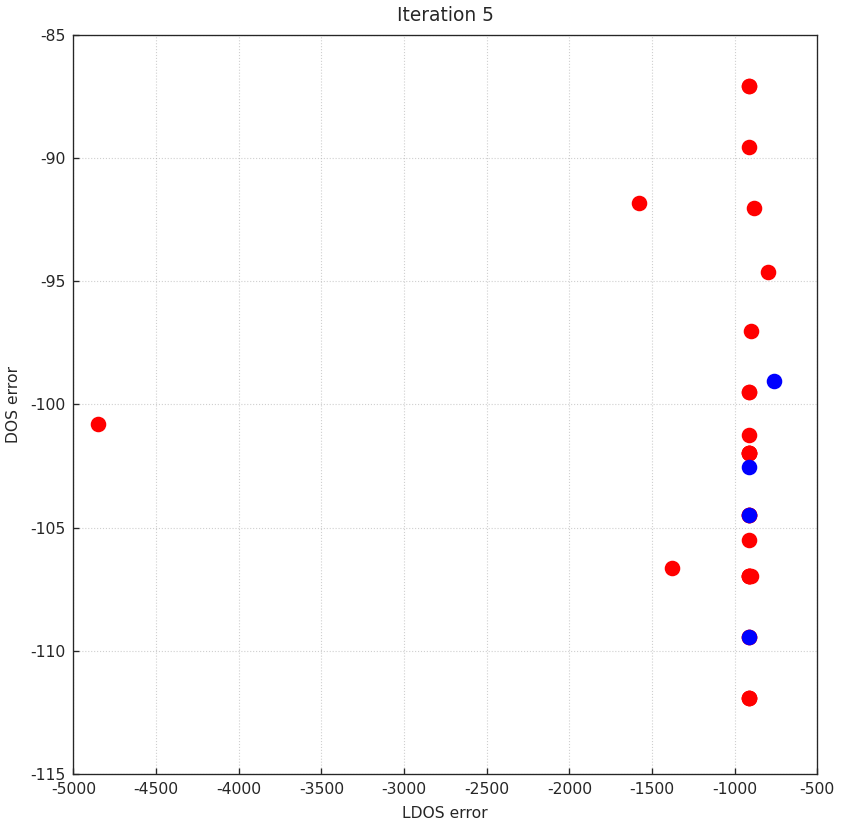


Batch  5: Hypervolume (qEHVI) = (100495.63) time = 6.20.
Next Point: tensor([[ 0.5360, -0.1909, -0.7588, -1.0757,  0.9091, -0.0447],
        [ 0.5546,  0.8790, -0.7182, -0.8095,  0.8754, -0.0833],
        [ 1.5000, -0.7634,  1.5000,  0.7721, -0.0051, -0.0231],
        [ 0.6246,  0.2737, -0.7122, -0.3692,  0.9584,  0.3553]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875,  -95.8016],
        [-914.9200, -101.9875],
        [-915.0875, -104.4750],
        [-915.0875, -104.4750]], dtype=torch.float64)


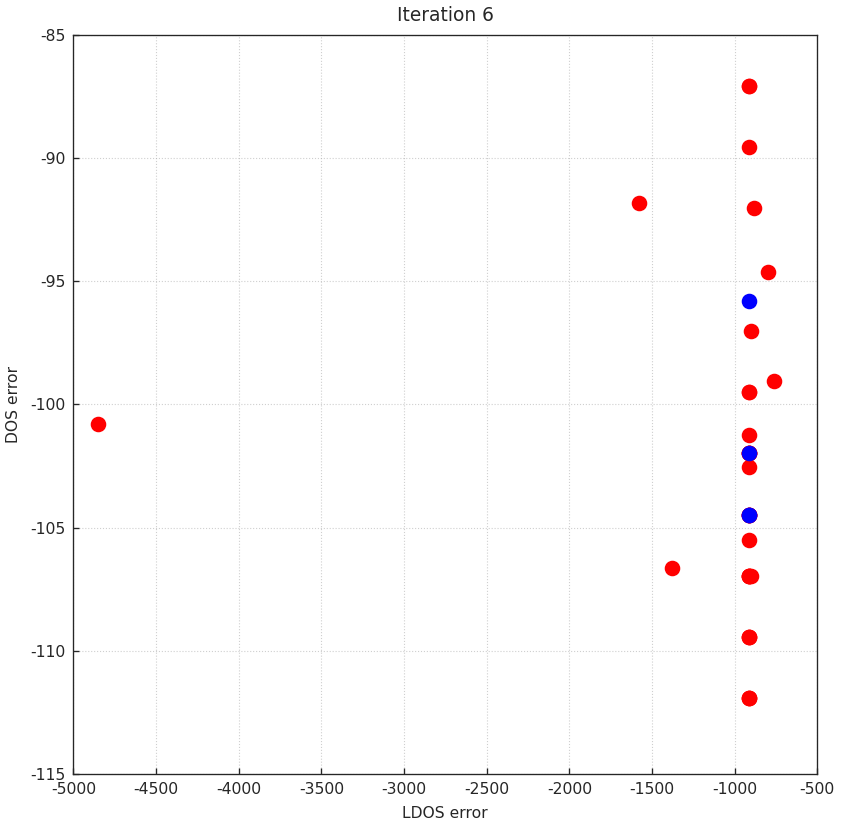


Batch  6: Hypervolume (qEHVI) = (100495.63) time = 9.01.
Next Point: tensor([[ 0.5250,  0.1293, -0.7298, -1.5000,  0.8657, -0.4686],
        [ 0.5472,  0.3422, -0.7403, -1.5000,  0.8091,  0.2851],
        [ 0.0321,  0.8956, -0.2605, -1.4539,  0.4484, -0.5666],
        [-0.5385, -0.6418, -0.5175,  0.7686, -0.5914,  0.3821]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875,  -99.5000],
        [-856.6782,  -97.0125],
        [-915.0875, -111.9375],
        [-915.0875, -106.9625]], dtype=torch.float64)


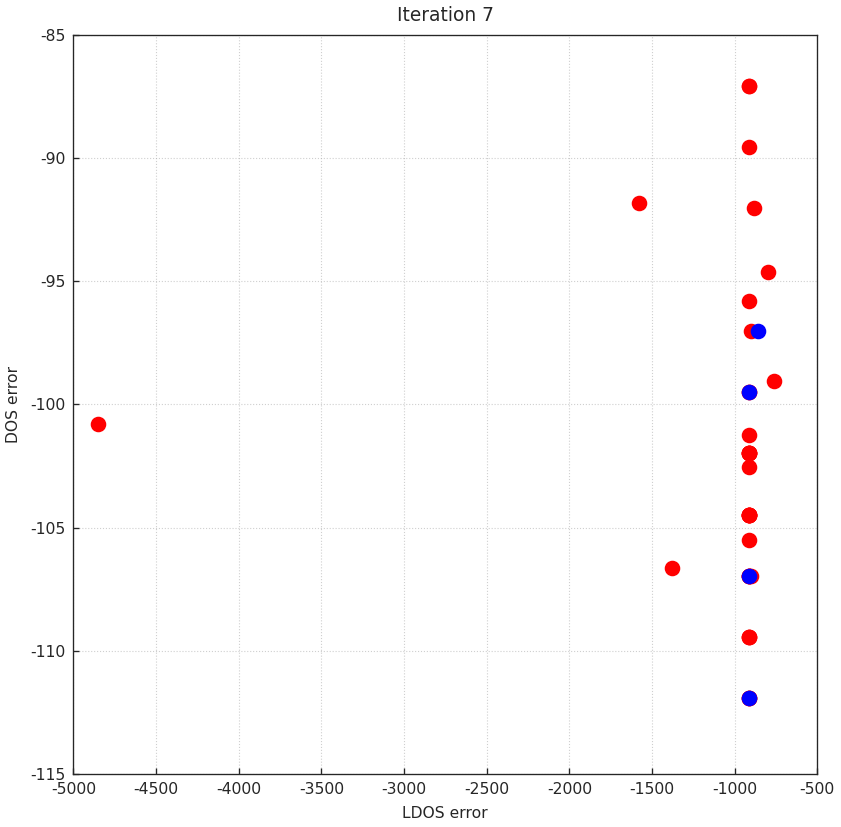


Batch  7: Hypervolume (qEHVI) = (100495.63) time = 7.55.
Next Point: tensor([[ 0.9119,  1.0996, -1.1195, -1.0477, -0.2998,  0.4261],
        [-1.4459,  1.5000,  1.5000,  0.0261,  1.1346, -0.8324],
        [ 0.5584,  0.1894, -0.8272, -1.0185,  0.7727,  1.0712],
        [-0.8907, -0.7936,  1.5000,  0.0912,  0.7003, -0.5843]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -104.4750],
        [-915.0875, -111.9375],
        [-915.0875, -107.1846],
        [-915.0875, -106.9625]], dtype=torch.float64)


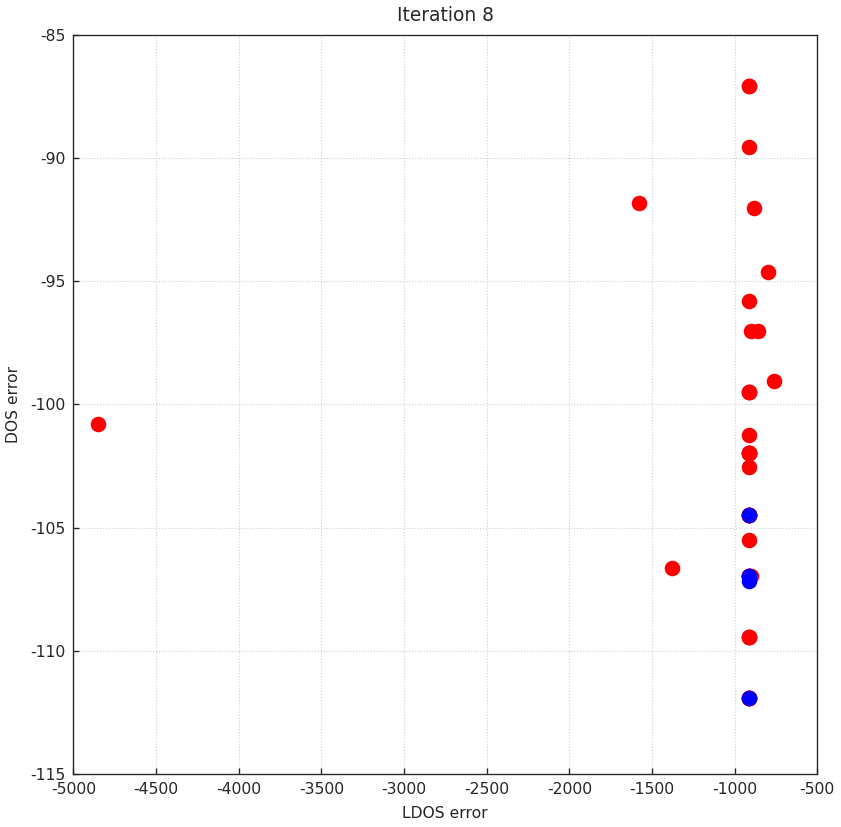


Batch  8: Hypervolume (qEHVI) = (100495.63) time = 7.06.
Next Point: tensor([[ 1.4746,  0.2693,  1.5000,  1.1368,  0.0081,  0.1566],
        [ 0.7867,  0.9284, -0.7423, -1.3918,  0.7264, -0.0763],
        [ 1.3784,  1.1462,  0.2914, -1.2714,  1.3483, -0.1074],
        [ 0.5482,  1.5000,  1.5000,  0.2177,  0.8889, -0.7532]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875,  -96.4639],
        [-842.3468, -105.4920],
        [-915.0875, -106.9625],
        [-915.0875, -109.4500]], dtype=torch.float64)


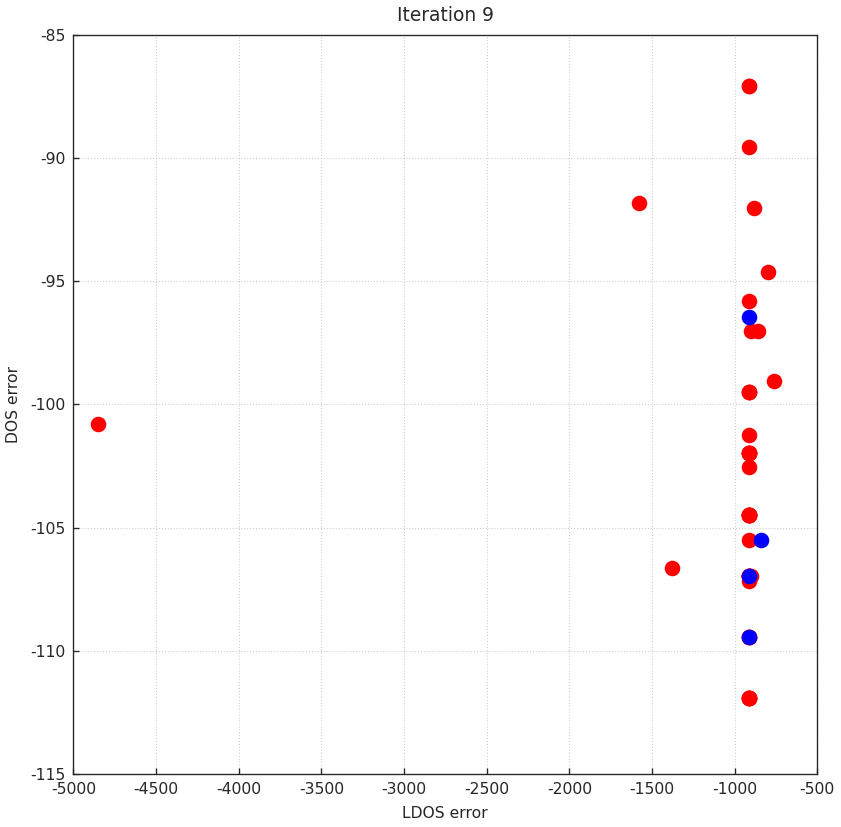


Batch  9: Hypervolume (qEHVI) = (100495.63) time = 8.63.
Next Point: tensor([[ 0.4833, -0.0716, -0.6776, -0.8538,  0.9135, -0.5819],
        [-1.2328,  0.1923, -0.6926, -0.9997, -0.2877,  0.0178],
        [ 0.0028,  0.2109, -1.5000,  0.8129,  0.5122,  0.5204],
        [ 1.5000,  0.1530,  1.4981,  0.0079,  0.0814,  0.2224]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875,  -99.5000],
        [-915.0875, -104.4750],
        [-915.0875, -111.9375],
        [-915.0875,  -84.5936]], dtype=torch.float64)


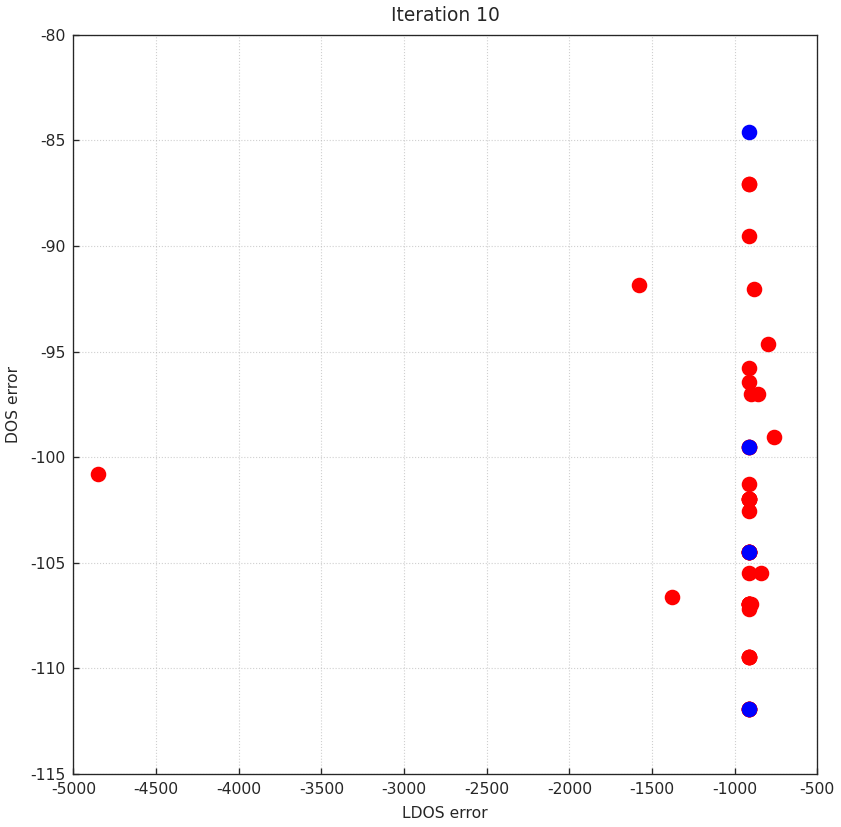


Batch 10: Hypervolume (qEHVI) = (110212.62) time = 9.79.
Next Point: tensor([[ 1.4232,  0.1781,  1.5000,  0.2448,  0.0785,  0.0641],
        [ 0.2178, -1.0710, -1.5000, -0.0229,  1.2398,  1.1918],
        [ 1.0010,  0.9332, -1.0825,  0.7813, -0.3298,  1.2605],
        [-1.2021, -0.9302, -0.4903,  1.5000,  0.0289,  0.4310]],
       dtype=torch.float64)

Next Objective: tensor([[-908.4586,  -92.0260],
        [-915.0875, -104.4750],
        [-915.0875, -109.8440],
        [-915.0875, -109.4500]], dtype=torch.float64)


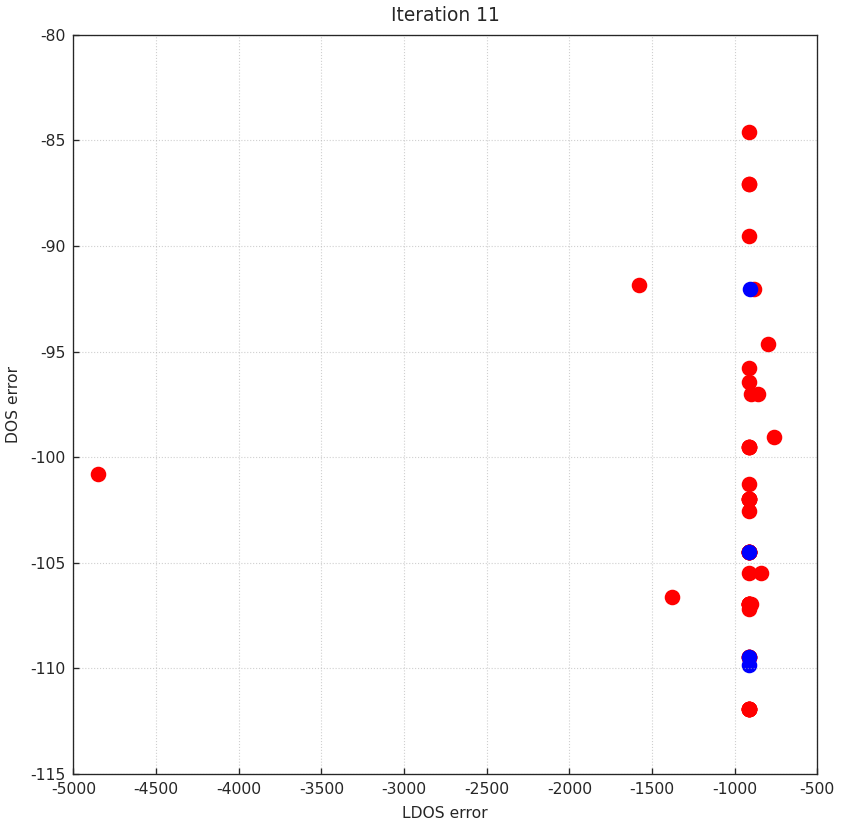


Batch 11: Hypervolume (qEHVI) = (110212.69) time = 10.10.
Next Point: tensor([[ 1.1644, -0.1302,  1.4196,  0.3529,  0.1185,  0.3523],
        [ 0.3194, -1.0820,  1.0205,  0.6551, -0.1152,  0.6267],
        [-0.7696, -1.0846,  0.3323,  0.0156, -0.0348,  0.1391],
        [ 0.8879, -1.3430,  1.5000,  1.2487, -0.4255,  0.8952]],
       dtype=torch.float64)

Next Objective: tensor([[-876.9385,  -89.5500],
        [-915.0875, -106.9625],
        [-787.0907, -101.9875],
        [-915.0875, -107.9175]], dtype=torch.float64)


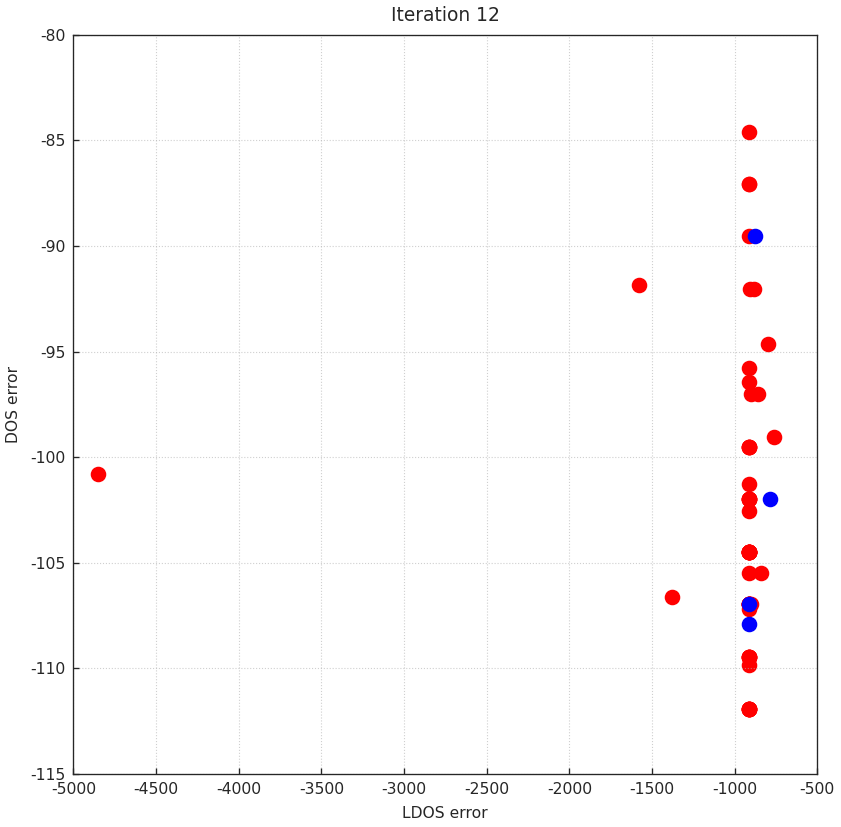


Batch 12: Hypervolume (qEHVI) = (110326.03) time = 15.01.
Next Point: tensor([[-0.7605, -0.7932,  0.3479,  0.1408, -0.0673, -0.1581],
        [ 0.1712,  0.0349,  0.7067, -1.2235,  1.5000, -0.9300],
        [-1.2279,  1.5000,  0.6104, -0.2208,  0.1805, -0.2188],
        [ 1.5000,  1.2918, -0.1323,  0.4352,  0.7314,  1.4176]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -104.4405],
        [-915.0875, -111.9375],
        [-915.0875, -106.9625],
        [-915.0875, -105.4353]], dtype=torch.float64)


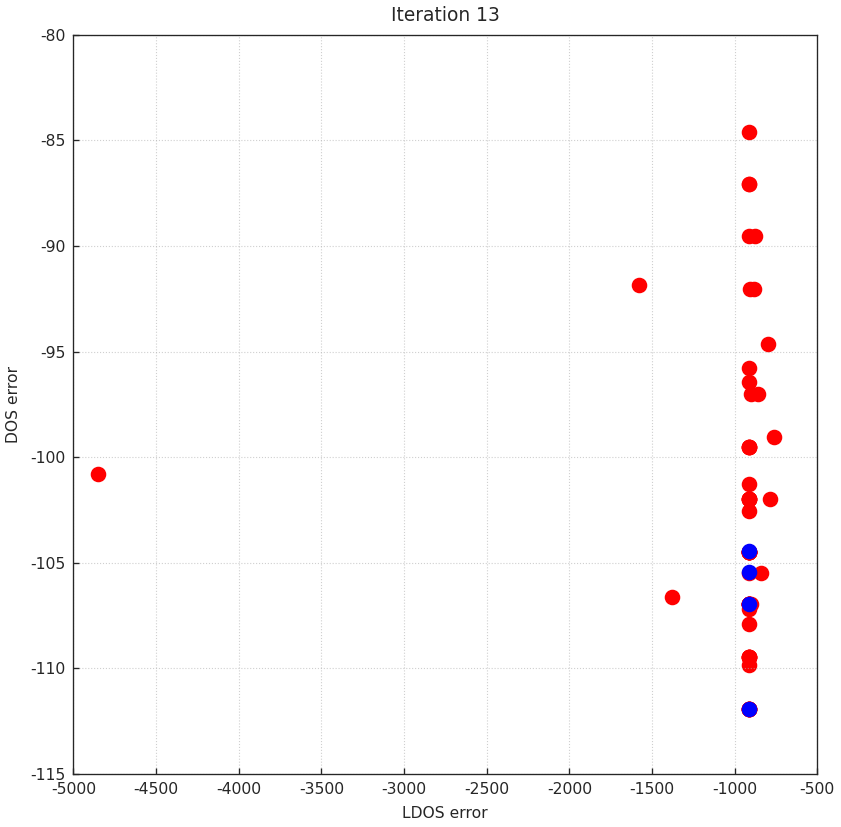


Batch 13: Hypervolume (qEHVI) = (110326.03) time = 11.12.
Next Point: tensor([[ 1.1457,  0.2487,  1.3816,  0.4769,  0.2642,  0.1021],
        [ 1.5000, -1.5000, -1.0136,  0.0778,  0.2408,  1.3876],
        [-0.9223,  1.3180, -0.5710, -1.5000, -1.5000,  0.2199],
        [ 0.4555, -1.5000, -1.5000, -0.8010, -0.0369,  0.2352]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0426,  -94.5250],
        [-914.8663, -109.4500],
        [-915.0875, -111.9375],
        [-915.0875, -111.9375]], dtype=torch.float64)


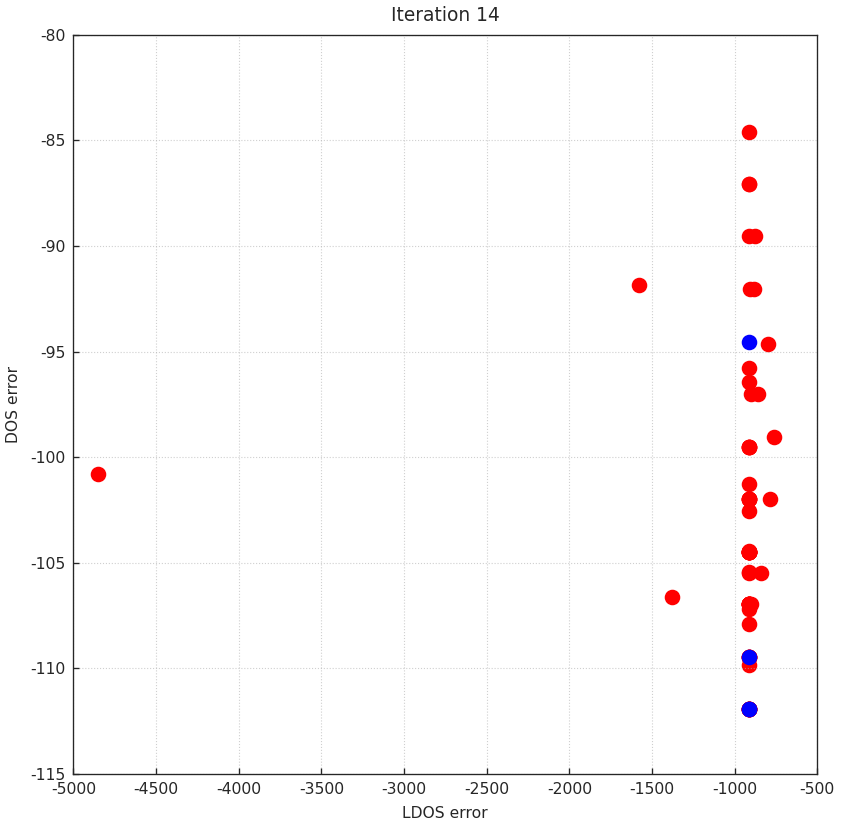


Batch 14: Hypervolume (qEHVI) = (110326.03) time = 8.06.
Next Point: tensor([[-1.5000, -1.5000,  0.2474, -0.0628, -0.4803,  0.0804],
        [-0.6040, -0.6826,  0.2873, -0.1978, -0.1396,  1.5000],
        [ 1.5000,  1.5000, -1.5000,  0.2203,  1.0271,  1.1373],
        [ 1.4868,  0.0872,  1.4618, -0.0861,  0.0870,  0.2092]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -104.4750],
        [-915.0875,  -97.6607],
        [-915.0875, -109.4500],
        [-915.0241,  -84.6213]], dtype=torch.float64)


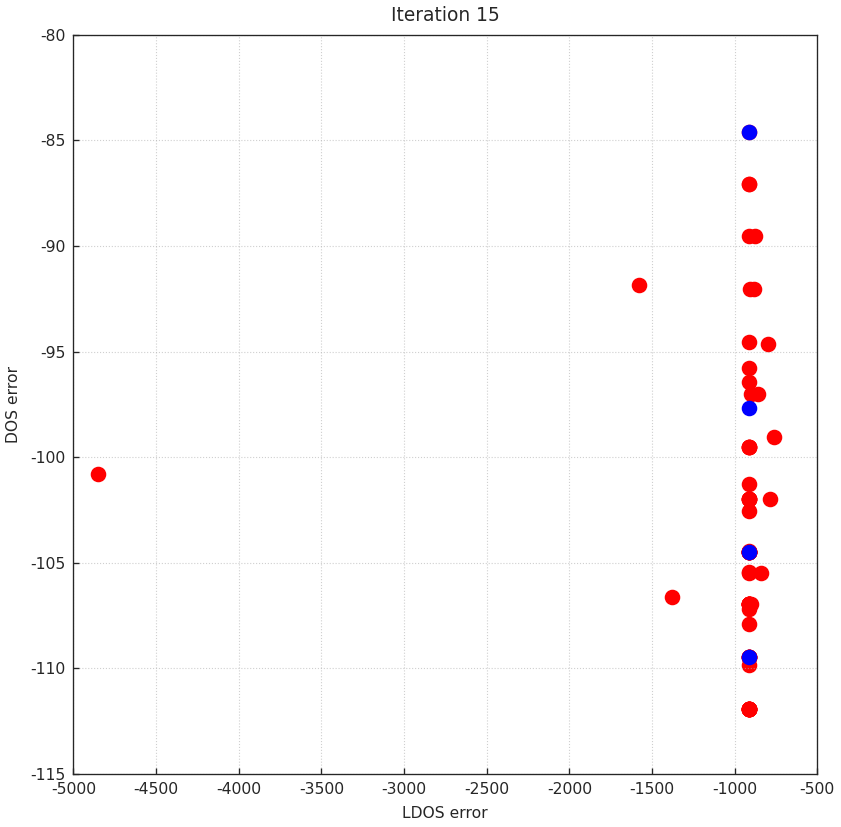


Batch 15: Hypervolume (qEHVI) = (110326.34) time = 10.54.
Next Point: tensor([[ 1.5000,  1.4391, -0.0940,  0.3096,  0.5103,  0.7415],
        [ 1.2302,  0.7305,  1.2152, -1.3574,  1.0973,  1.5000],
        [ 1.2523, -0.0039,  1.3704,  0.8056,  0.1062,  0.5558],
        [-0.5657, -0.6265,  0.2814,  1.3974, -0.1050,  1.5000]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -104.4750],
        [-915.0875, -106.9632],
        [-915.0875,  -99.5371],
        [-915.0875, -109.4500]], dtype=torch.float64)


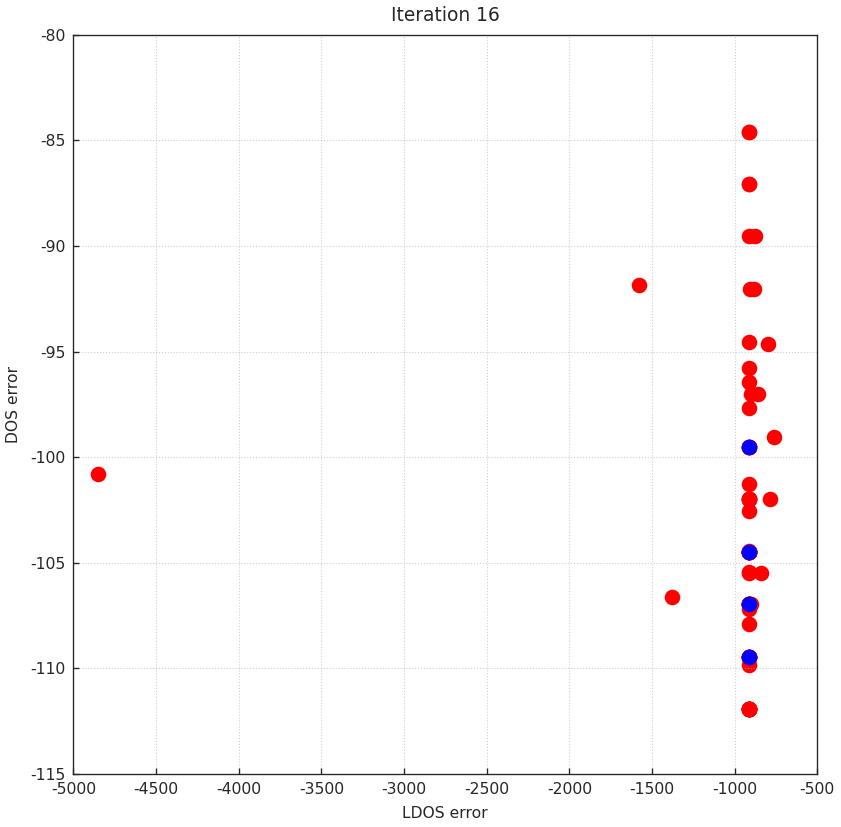


Batch 16: Hypervolume (qEHVI) = (110326.34) time = 8.79.
Next Point: tensor([[-1.3061,  1.2555,  0.5668, -0.9657,  0.7745, -0.5740],
        [ 1.4853,  0.4988, -1.5000, -0.0495, -1.3145,  0.4853],
        [-0.9753, -1.3010, -1.5000, -1.5000, -0.9019,  0.8747],
        [ 0.4864, -0.0966, -0.7344, -1.0620,  0.6103, -0.1294]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -109.4500],
        [-915.0875, -106.9625],
        [-915.0875, -109.4500],
        [-915.0875,  -99.4999]], dtype=torch.float64)


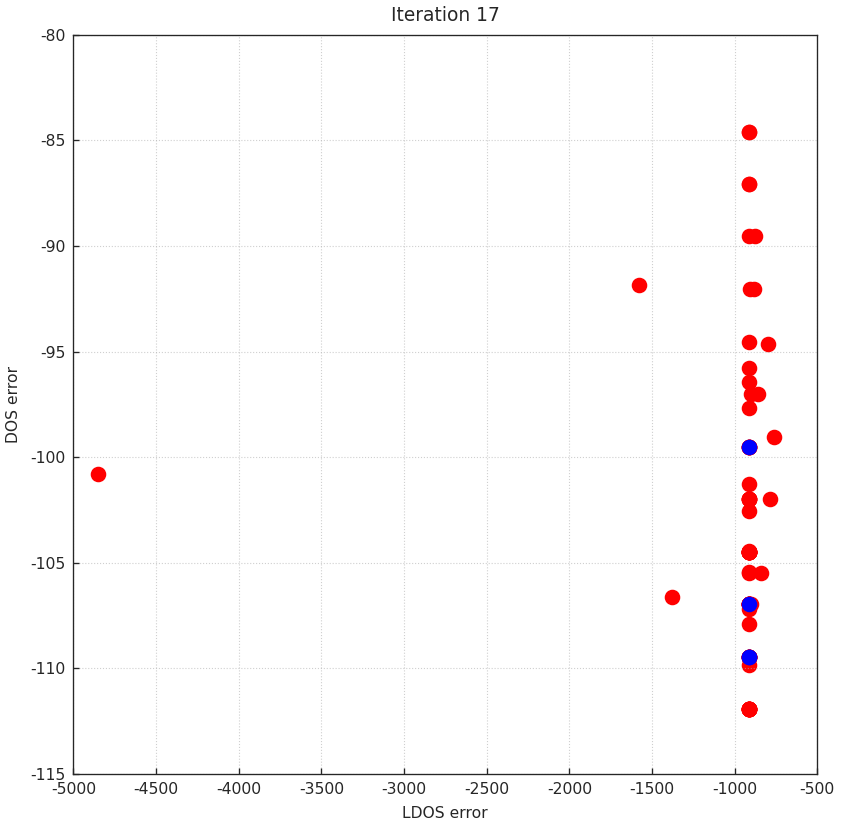


Batch 17: Hypervolume (qEHVI) = (110326.34) time = 9.67.
Next Point: tensor([[ 0.0970,  1.4209, -0.6071, -0.8546,  1.5000, -0.7083],
        [ 0.7680, -1.5000, -0.6492,  0.1703, -1.4694,  1.3762],
        [-1.5000,  1.4855, -1.5000,  0.2607,  0.3661,  1.5000],
        [ 1.5000,  1.2799, -1.5000, -1.5000,  1.5000,  0.4428]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -109.4500],
        [-915.0875, -106.9625],
        [-915.0875, -106.9625],
        [-915.0875, -107.2042]], dtype=torch.float64)


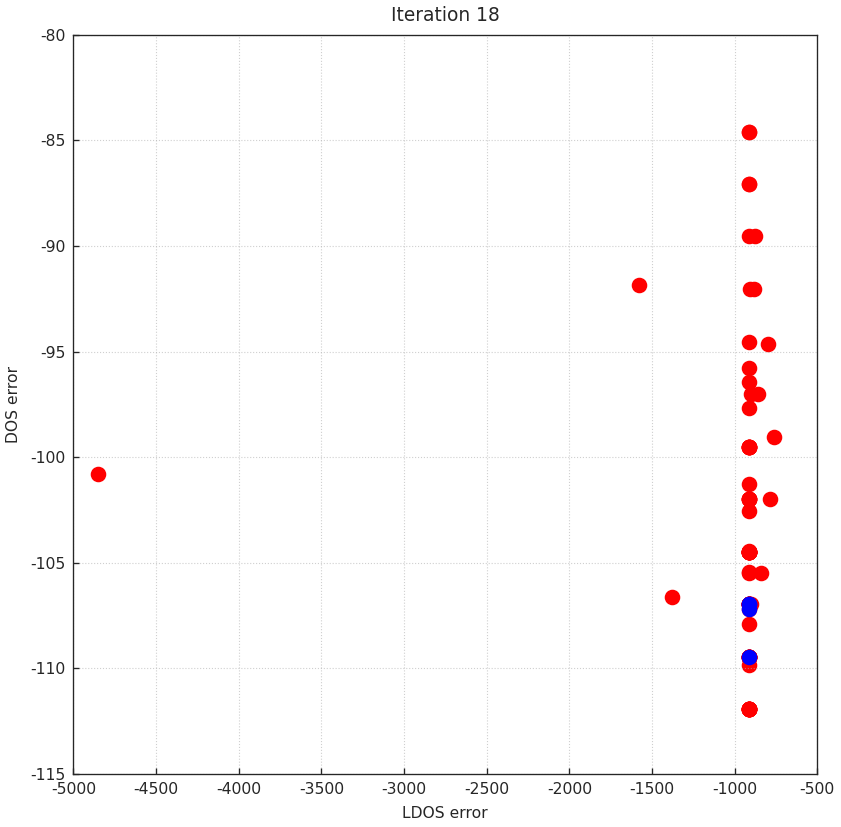


Batch 18: Hypervolume (qEHVI) = (110326.34) time = 7.82.
Next Point: tensor([[-1.5000,  1.3448, -1.5000, -0.0036, -1.5000,  1.2651],
        [ 1.5000, -1.5000, -1.5000, -1.5000, -1.5000,  0.8247],
        [-1.5000, -1.5000, -1.5000,  1.5000, -0.4404,  1.5000],
        [-1.5000, -1.5000,  0.9559,  1.5000, -1.5000,  1.2424]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -109.4500],
        [-915.0875, -108.9237],
        [-915.0875, -111.9375],
        [-915.0875, -109.4500]], dtype=torch.float64)


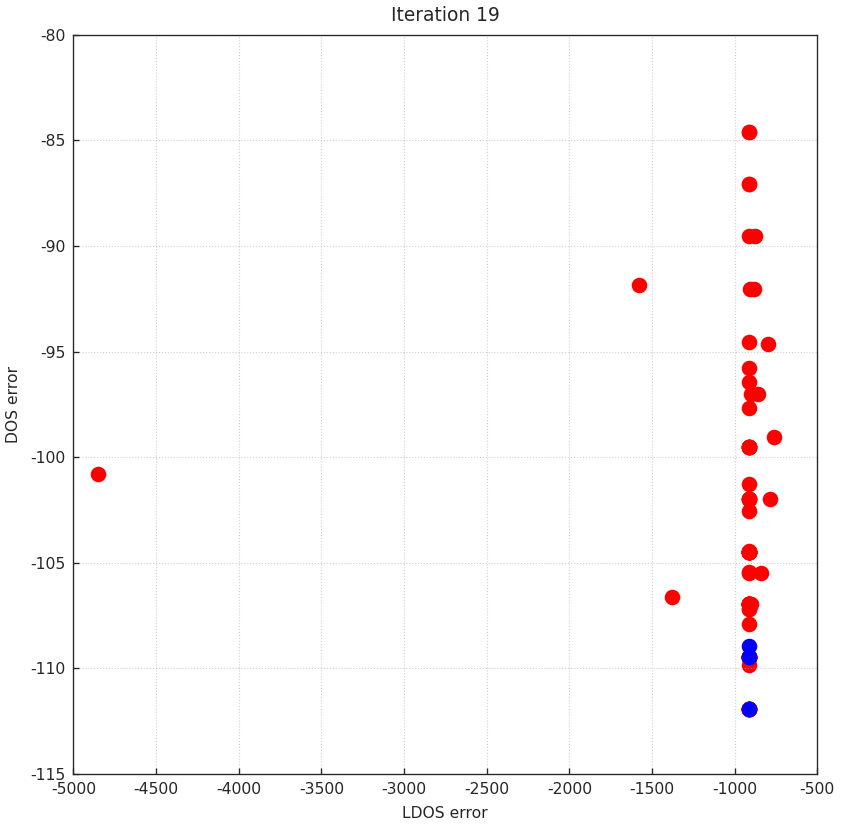


Batch 19: Hypervolume (qEHVI) = (110326.34) time = 7.64.
Next Point: tensor([[-0.6413, -0.6775,  0.2692, -0.1974, -0.2122,  1.0697],
        [-1.5000,  1.5000, -0.1301,  1.5000, -1.3449,  1.5000],
        [-1.5000, -1.5000, -1.5000,  1.5000, -1.5000,  0.7631],
        [ 0.5984, -0.1149,  1.1308,  1.5000, -1.2343,  1.5000]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875,  -99.5000],
        [-915.0875, -103.1342],
        [-915.0875, -109.4500],
        [-915.0875, -104.4750]], dtype=torch.float64)


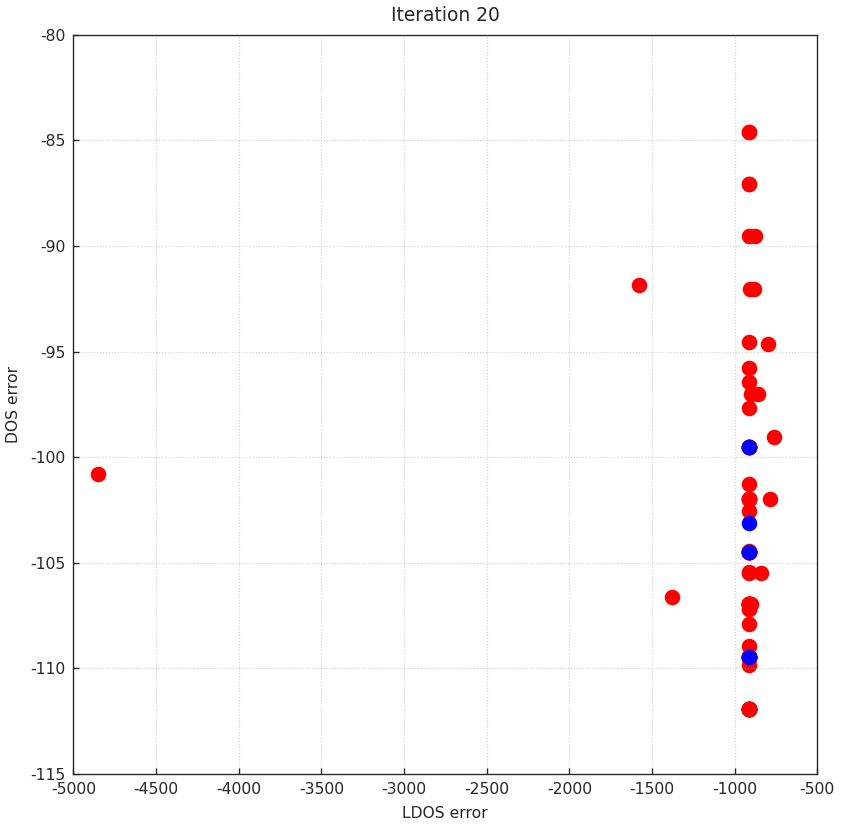


Batch 20: Hypervolume (qEHVI) = (110326.34) time = 7.98.
Next Point: tensor([[-1.5000,  1.5000, -0.1202,  1.5000, -1.3534,  0.8232],
        [ 0.2344, -1.5000,  0.8461, -1.3300, -1.5000, -0.0082],
        [-0.6462, -0.7893,  0.2898, -0.3830, -0.6144,  1.5000],
        [ 1.5000, -1.0065, -1.5000,  1.5000,  1.5000, -0.3687]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -101.9681],
        [-915.0875,  -97.0125],
        [-866.7461, -101.9849],
        [-915.0875, -106.9625]], dtype=torch.float64)


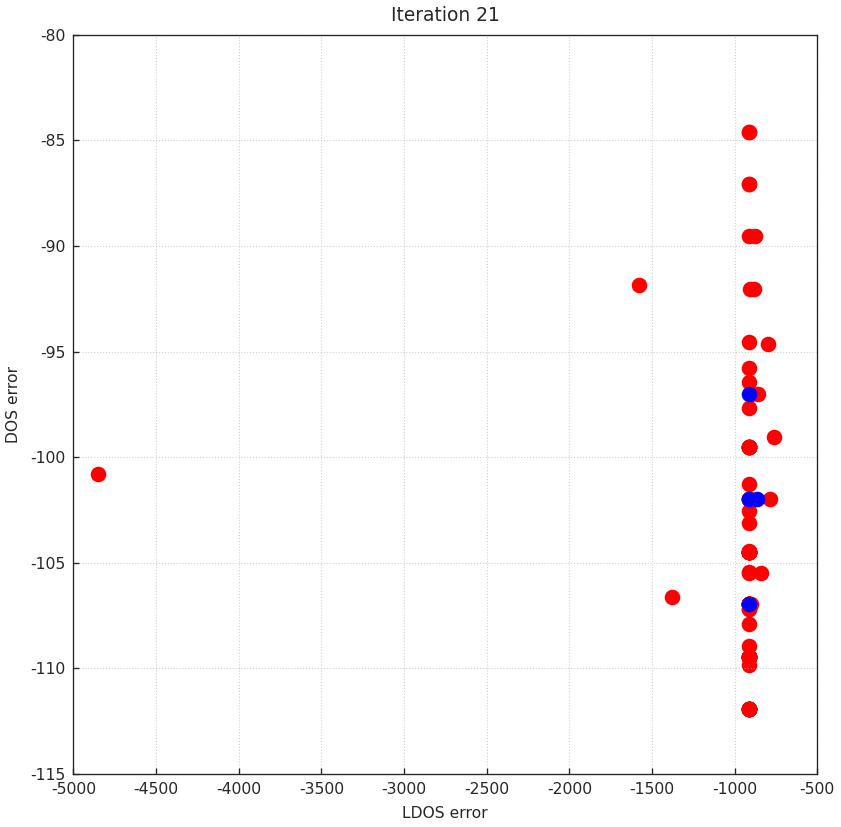


Batch 21: Hypervolume (qEHVI) = (110326.34) time = 9.70.
Next Point: tensor([[ 0.2055, -1.4879,  0.8528, -1.2866, -1.4668,  0.6183],
        [ 0.3322,  0.0070,  1.0658,  1.3971, -1.5000, -0.1403],
        [-1.5000,  1.5000, -0.1396,  1.5000, -1.3218,  0.0356],
        [ 1.5000, -1.5000, -1.5000,  1.5000, -0.9266,  1.1178]],
       dtype=torch.float64)

Next Objective: tensor([[-912.6434, -104.4750],
        [-915.0875, -102.6947],
        [-915.0875,  -99.5000],
        [-915.0875, -111.9375]], dtype=torch.float64)


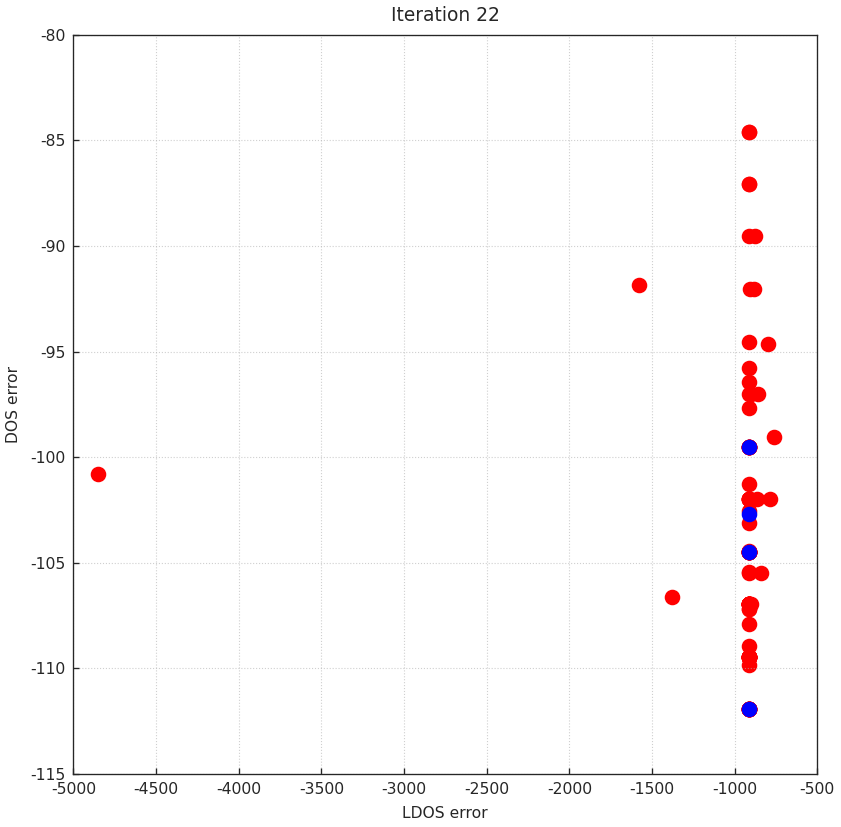


Batch 22: Hypervolume (qEHVI) = (110326.34) time = 10.62.
Next Point: tensor([[ 0.5181,  0.2559, -0.6386,  1.4183,  0.1000,  0.0667],
        [ 0.2383, -1.5000,  0.8419, -1.3880, -1.5000, -0.5149],
        [ 1.0369,  1.2071, -1.1393, -1.3390, -0.9543,  1.5000],
        [-1.5000,  1.5000, -1.5000, -1.5000,  1.5000,  1.5000]],
       dtype=torch.float64)

Next Objective: tensor([[-787.2871,  -97.0008],
        [-915.0875, -101.9875],
        [-915.0875, -111.9375],
        [-915.0875, -109.4500]], dtype=torch.float64)


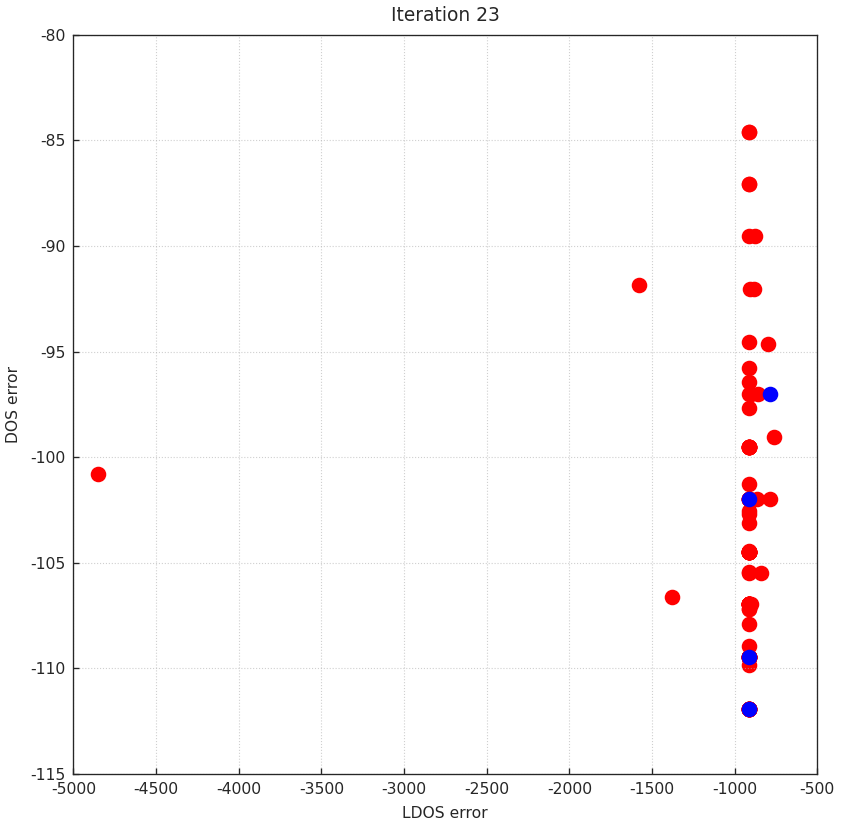


Batch 23: Hypervolume (qEHVI) = (110350.00) time = 8.06.
Next Point: tensor([[-1.5000,  1.5000,  1.5000,  1.5000,  1.5000,  1.5000],
        [ 0.5765,  0.2907, -0.6434,  1.4134,  0.0393,  0.3083],
        [ 1.5000, -1.1559, -1.5000, -1.5000,  1.5000,  1.5000],
        [-1.5000,  0.4648,  1.5000, -1.5000, -1.2473,  1.5000]],
       dtype=torch.float64)

Next Objective: tensor([[ -915.0875,  -104.4750],
        [-1675.2366,   -97.7532],
        [ -915.0875,  -109.4500],
        [ -896.4471,  -106.4835]], dtype=torch.float64)


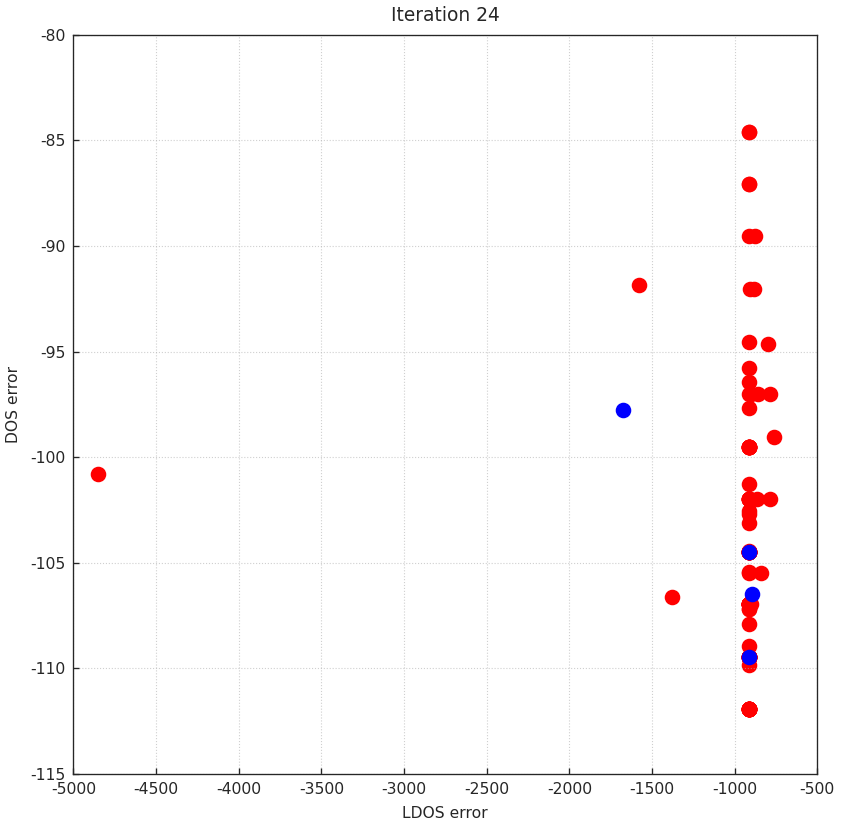


Batch 24: Hypervolume (qEHVI) = (110350.00) time = 6.87.
Next Point: tensor([[ 0.5218,  0.2159, -0.6105,  1.2550,  0.1671, -0.2230],
        [ 1.0485,  0.7299,  0.3020,  1.5000,  1.0312, -0.3371],
        [ 1.4859,  0.0960,  1.4362, -0.0128,  0.0918, -0.4007],
        [-1.5000,  1.5000,  1.5000, -1.5000, -1.5000, -0.2978]],
       dtype=torch.float64)

Next Objective: tensor([[-905.0797, -101.9875],
        [-899.4037, -104.4750],
        [-900.7705,  -92.2527],
        [-915.0875, -109.4500]], dtype=torch.float64)


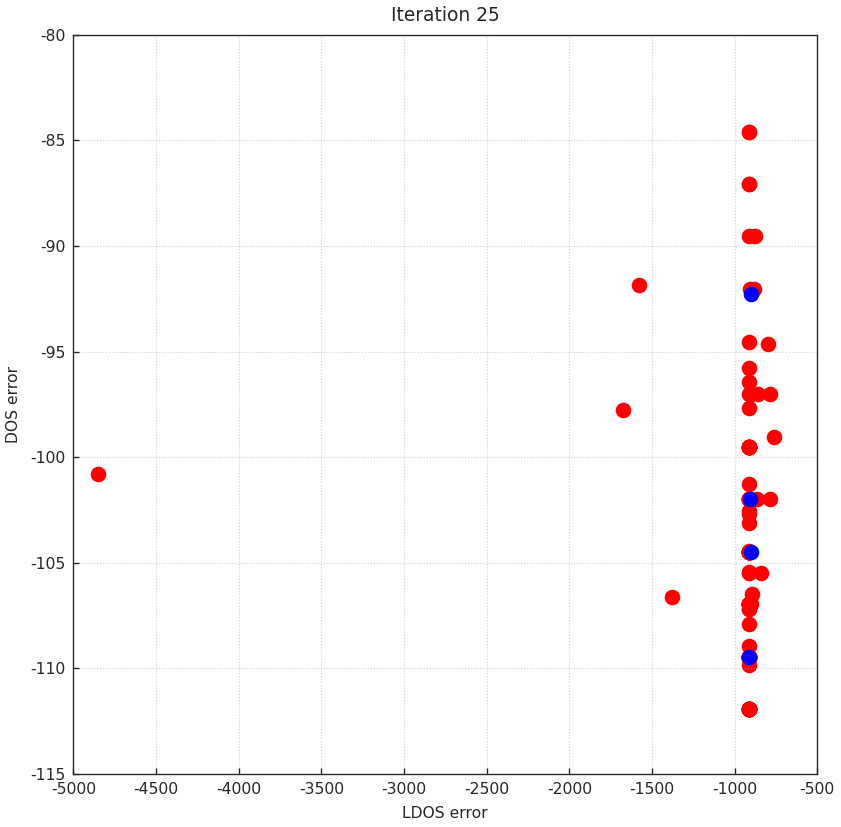


Batch 25: Hypervolume (qEHVI) = (110350.00) time = 11.48.
Next Point: tensor([[-1.5000, -1.4925,  0.2475,  0.7536, -0.8534,  0.6494],
        [-1.5000,  1.5000, -1.5000, -1.2940,  0.2274,  0.6997],
        [-1.5000,  1.5000,  1.5000,  1.5000,  0.0374,  1.1277],
        [ 1.2589,  0.1306,  1.4051,  0.7154,  0.1921, -0.2878]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -106.9625],
        [-915.0875, -111.7596],
        [-915.0875, -111.9375],
        [-915.0875,  -94.5250]], dtype=torch.float64)


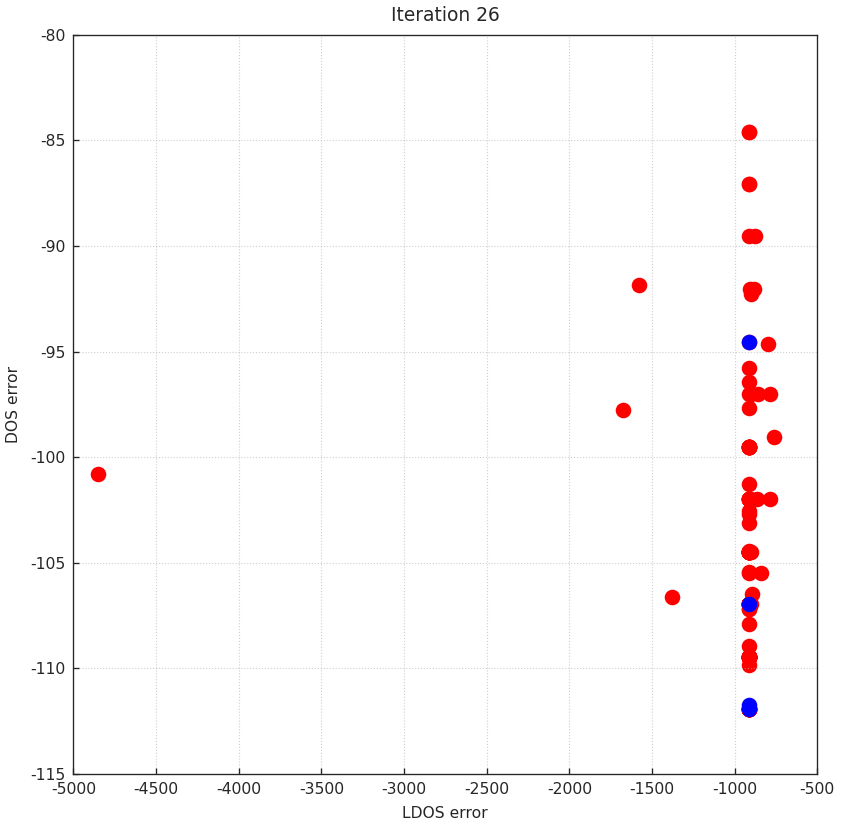


Batch 26: Hypervolume (qEHVI) = (110350.00) time = 10.32.
Next Point: tensor([[-0.9290, -1.5000,  0.3629,  1.5000, -0.2605, -0.0452],
        [ 1.3915,  0.1686,  1.4490, -0.8205,  0.1479, -0.5480],
        [ 1.5000,  1.5000,  0.1281, -1.5000, -1.5000, -0.2581],
        [ 1.5000,  1.5000,  1.0080, -0.7864,  1.5000, -1.2664]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -108.2028],
        [-915.0875, -104.4750],
        [-915.0875, -111.9375],
        [-915.0875, -111.9375]], dtype=torch.float64)


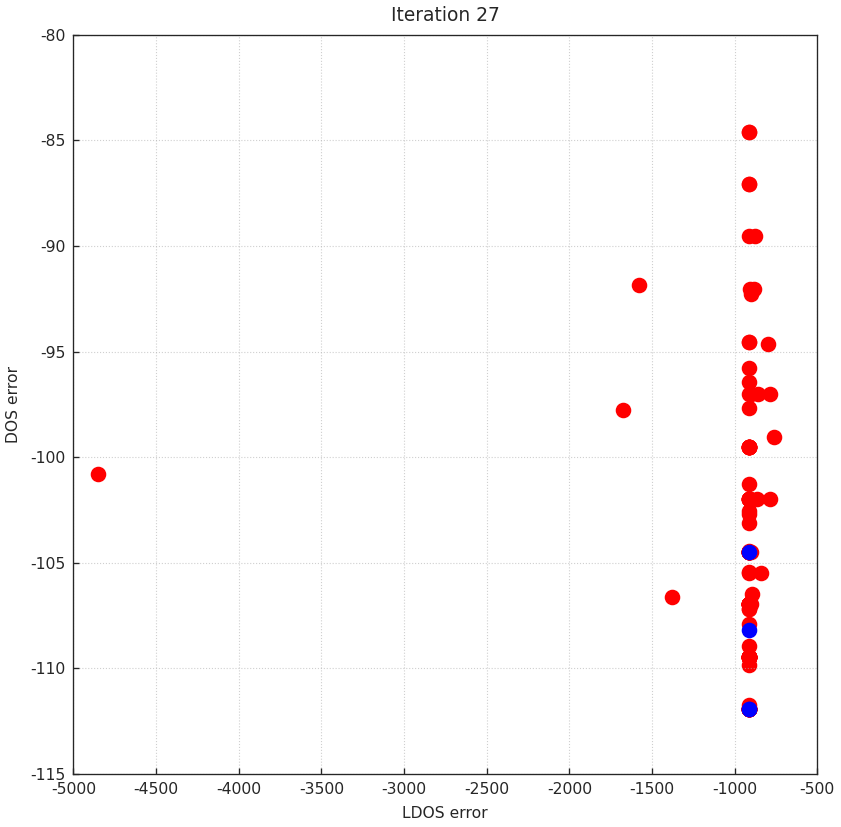


Batch 27: Hypervolume (qEHVI) = (110350.00) time = 12.33.
Next Point: tensor([[ 1.5000, -1.5000,  0.9261,  1.5000,  1.5000,  1.5000],
        [-1.5000,  1.5000, -0.6621,  1.5000,  1.5000,  1.1344],
        [-0.0904, -1.5000, -0.9361, -0.4039, -1.5000,  0.0393],
        [ 1.2263,  0.1075,  1.4323,  0.9080,  0.2667,  0.2648]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0875, -111.9375],
        [-915.0875,  -99.4920],
        [-915.0875, -109.4500],
        [-915.0875,  -92.0375]], dtype=torch.float64)


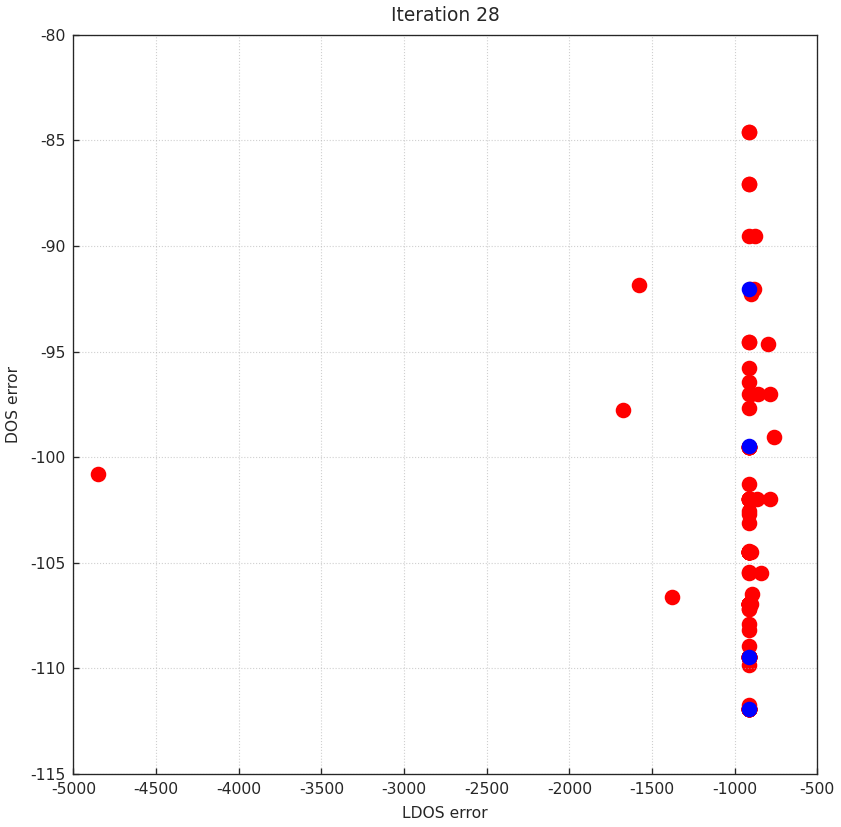


Batch 28: Hypervolume (qEHVI) = (110350.00) time = 11.65.
Next Point: tensor([[ 1.1324,  0.2336,  1.4881,  1.2587,  0.3353,  0.6467],
        [-1.4894,  1.5000, -0.6550,  1.5000,  1.5000,  1.5000],
        [-1.3335,  1.5000, -1.5000,  1.5000,  1.5000,  0.1184],
        [ 1.5000,  0.0652,  1.4532, -0.0435,  0.0882,  0.1950]],
       dtype=torch.float64)

Next Objective: tensor([[-915.0480,  -97.0125],
        [-915.0875,  -99.5000],
        [-914.5487, -106.9485],
        [-915.0875,  -84.5754]], dtype=torch.float64)


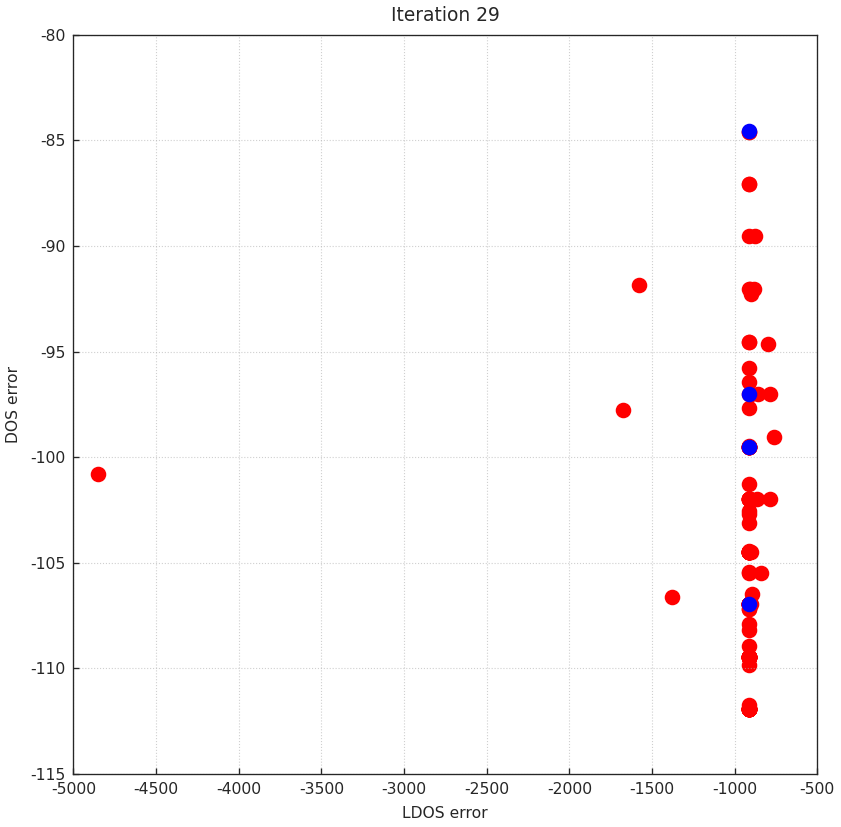


Batch 29: Hypervolume (qEHVI) = (110421.27) time = 15.51.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R

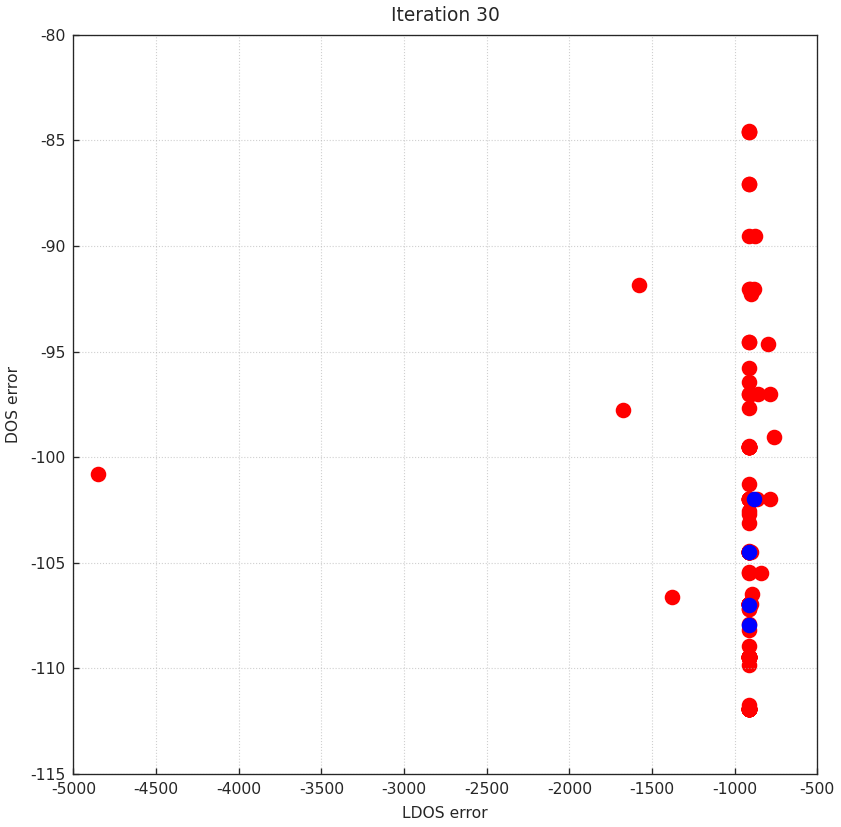


Batch 30: Hypervolume (qEHVI) = (110421.27) time = 13.32.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R

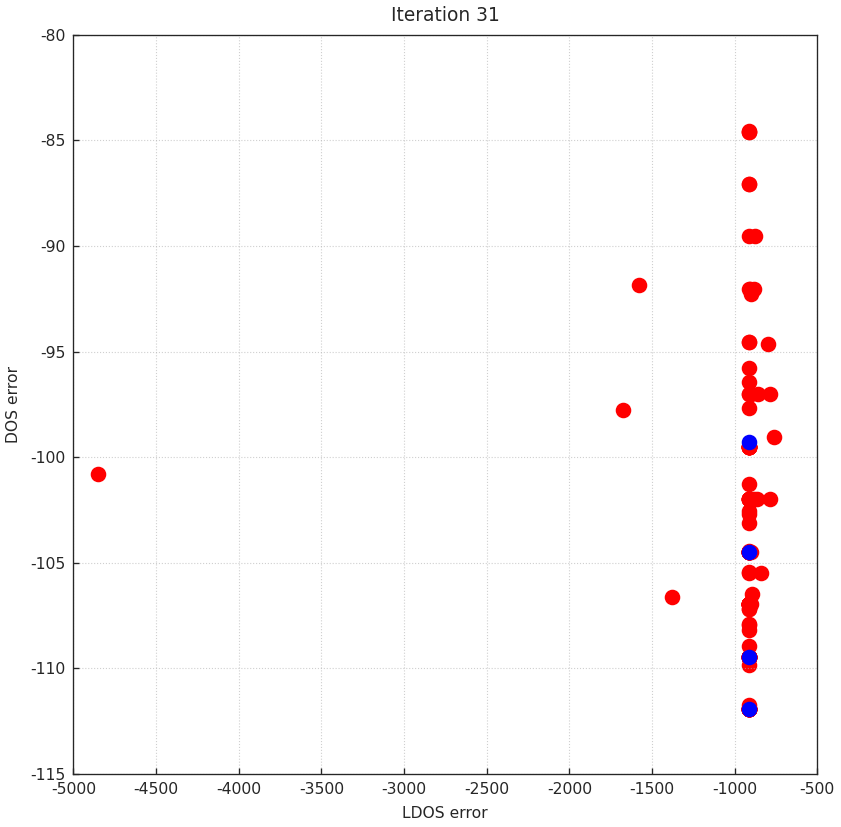


Batch 31: Hypervolume (qEHVI) = (110421.27) time = 11.03.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R

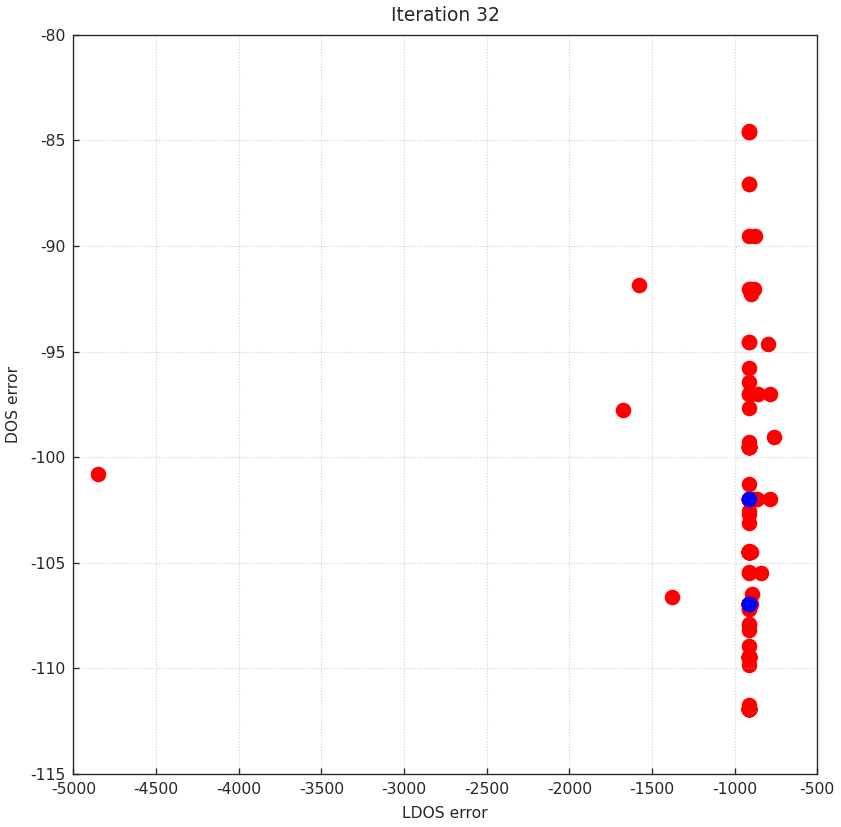


Batch 32: Hypervolume (qEHVI) = (110421.27) time = 7.75.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R)

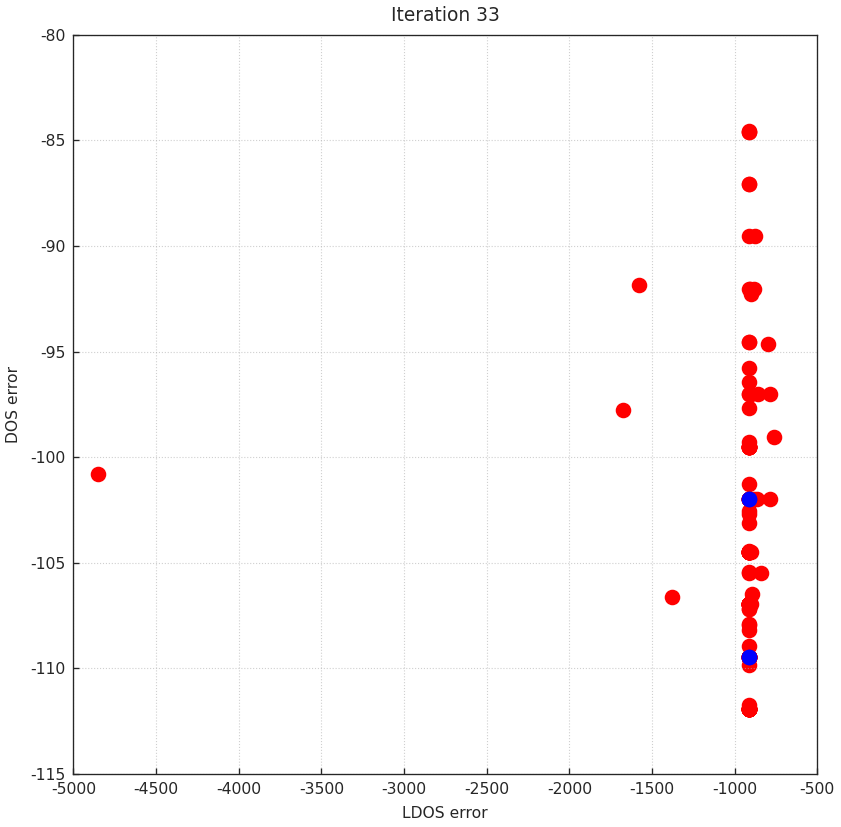


Batch 33: Hypervolume (qEHVI) = (110421.27) time = 9.56.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R)

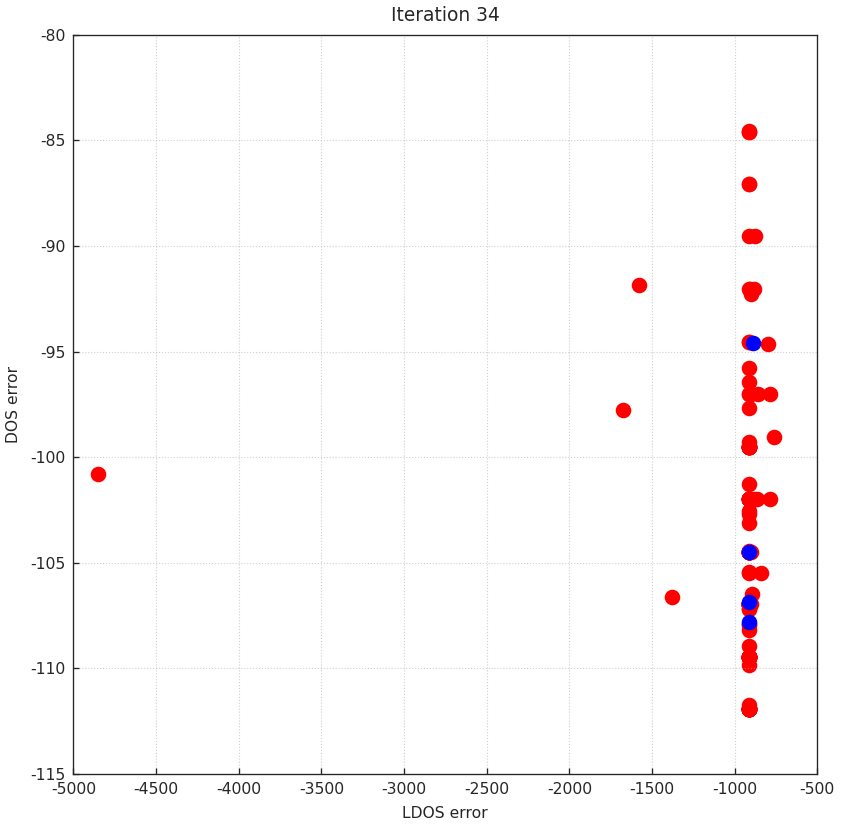


Batch 34: Hypervolume (qEHVI) = (110421.27) time = 7.70.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R)

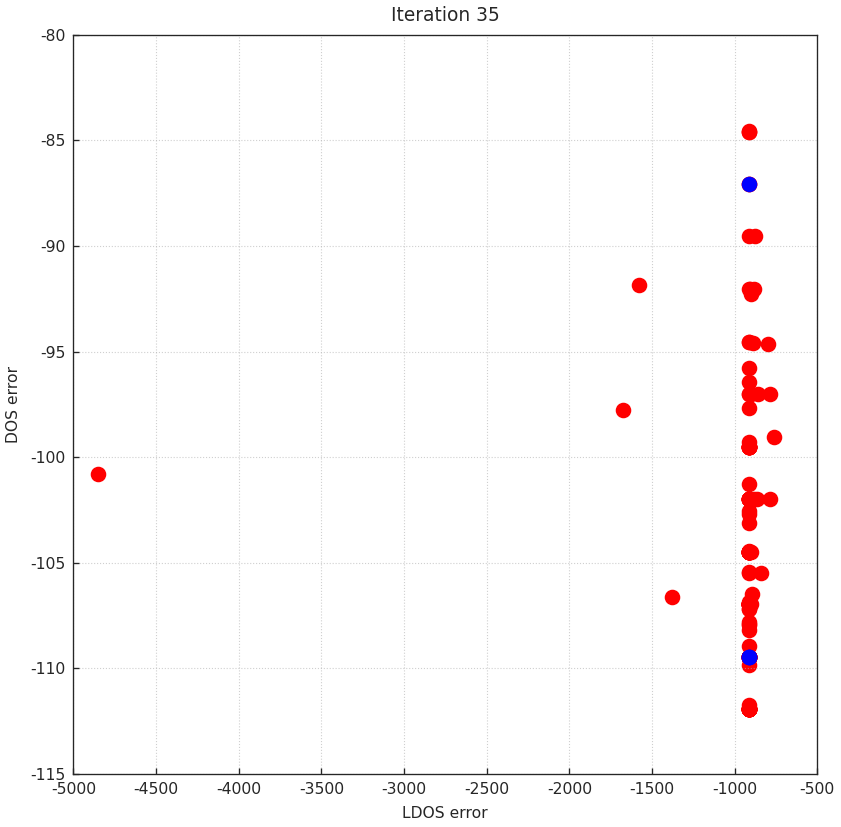


Batch 35: Hypervolume (qEHVI) = (110422.64) time = 9.47.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R)

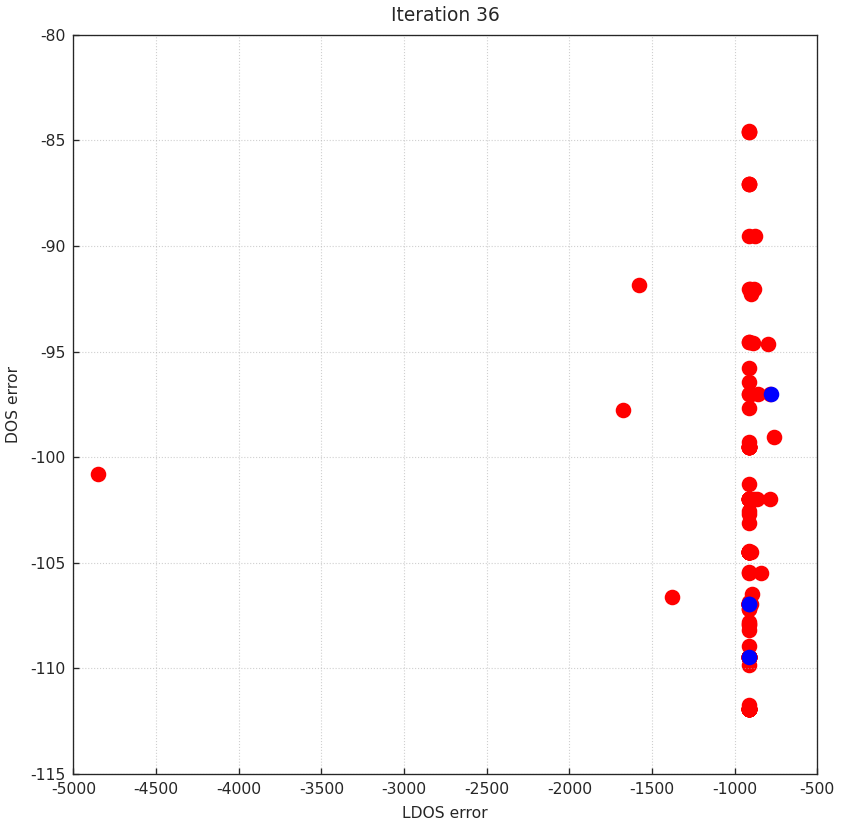


Batch 36: Hypervolume (qEHVI) = (110434.27) time = 10.31.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R)

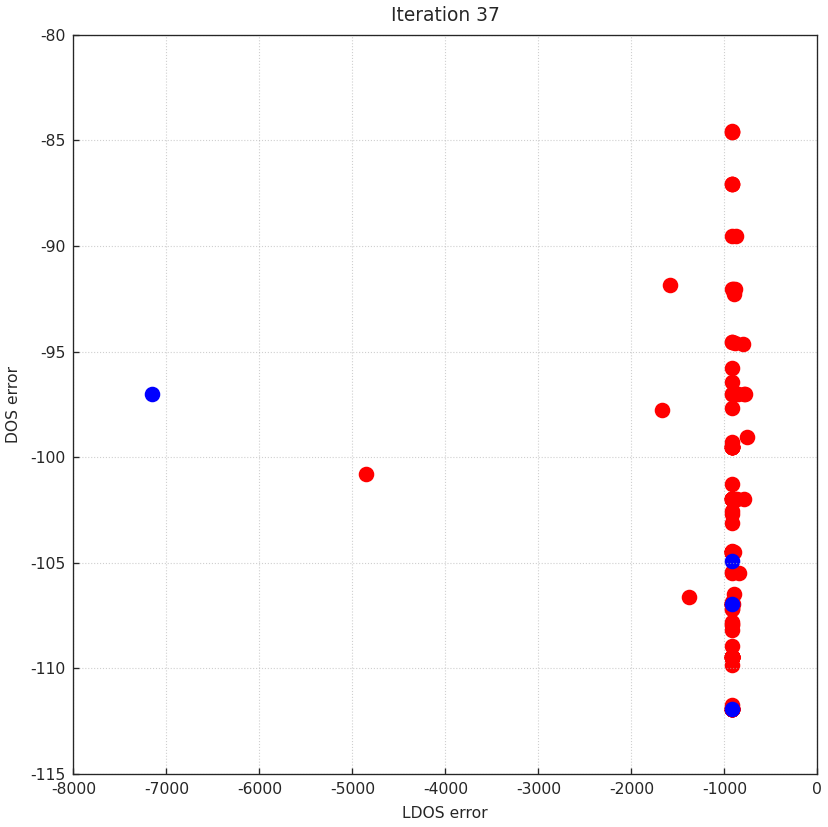


Batch 37: Hypervolume (qEHVI) = (110434.27) time = 7.91.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R)

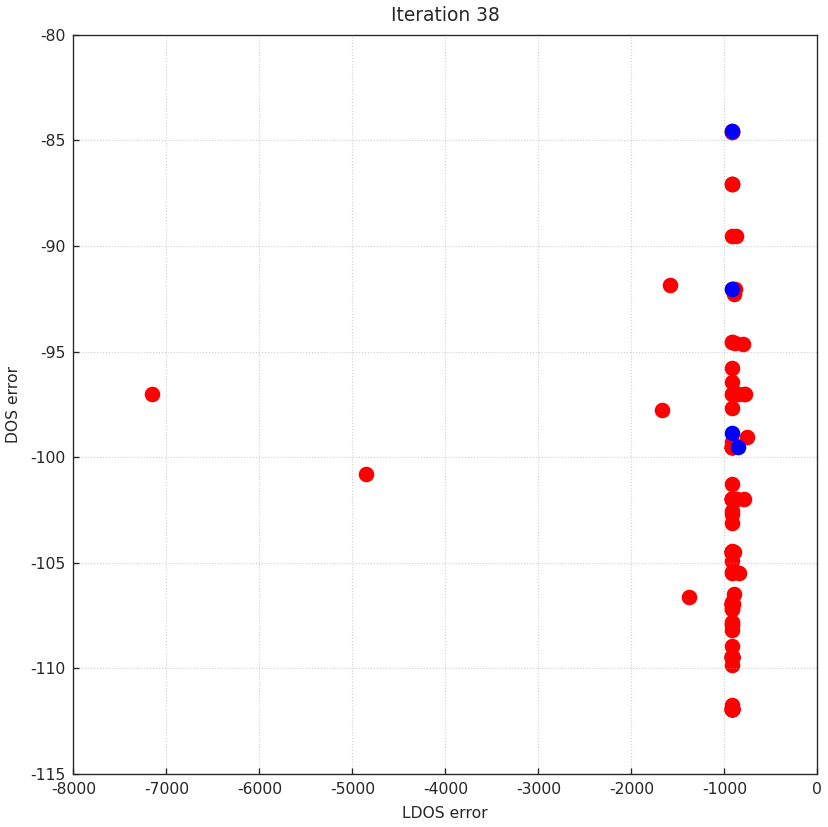


Batch 38: Hypervolume (qEHVI) = (110436.00) time = 16.91.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R)

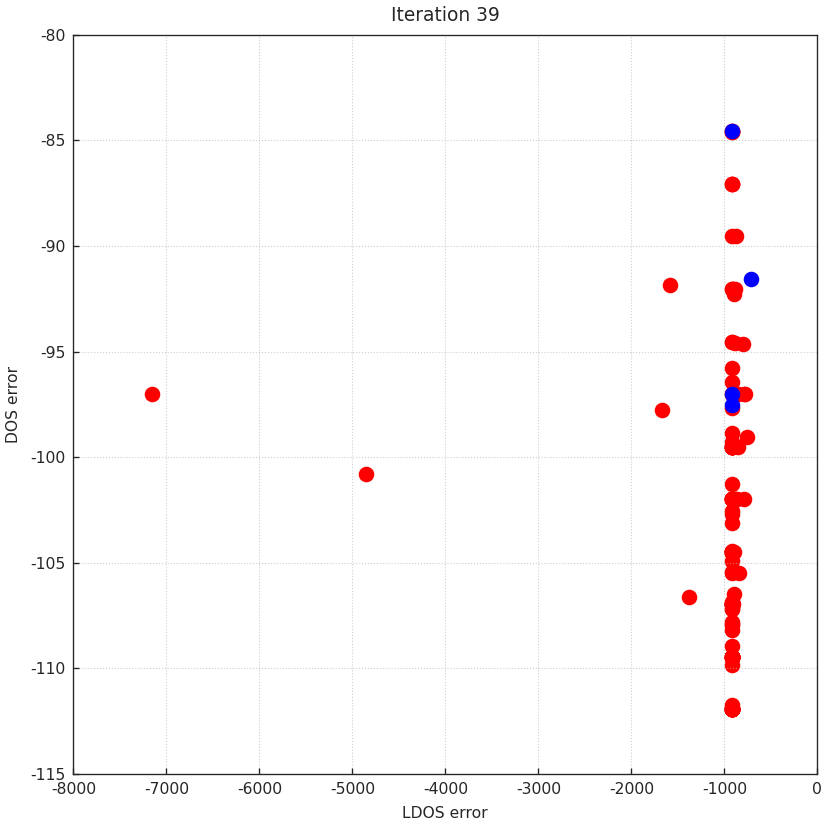


Batch 39: Hypervolume (qEHVI) = (111863.00) time = 13.58.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R

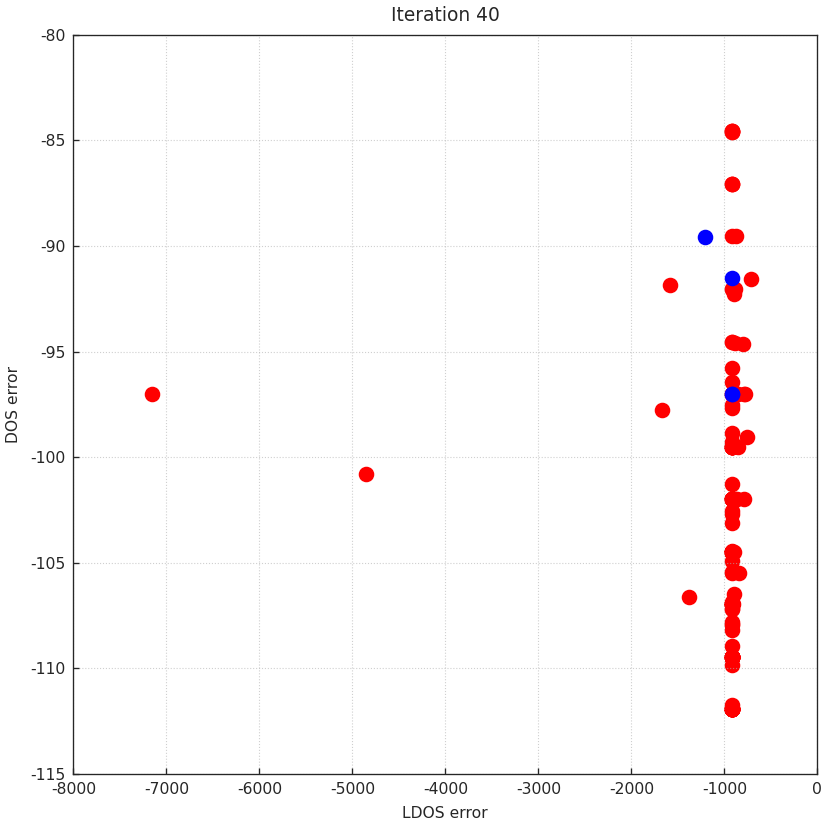


Batch 40: Hypervolume (qEHVI) = (111863.00) time = 16.58.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) A

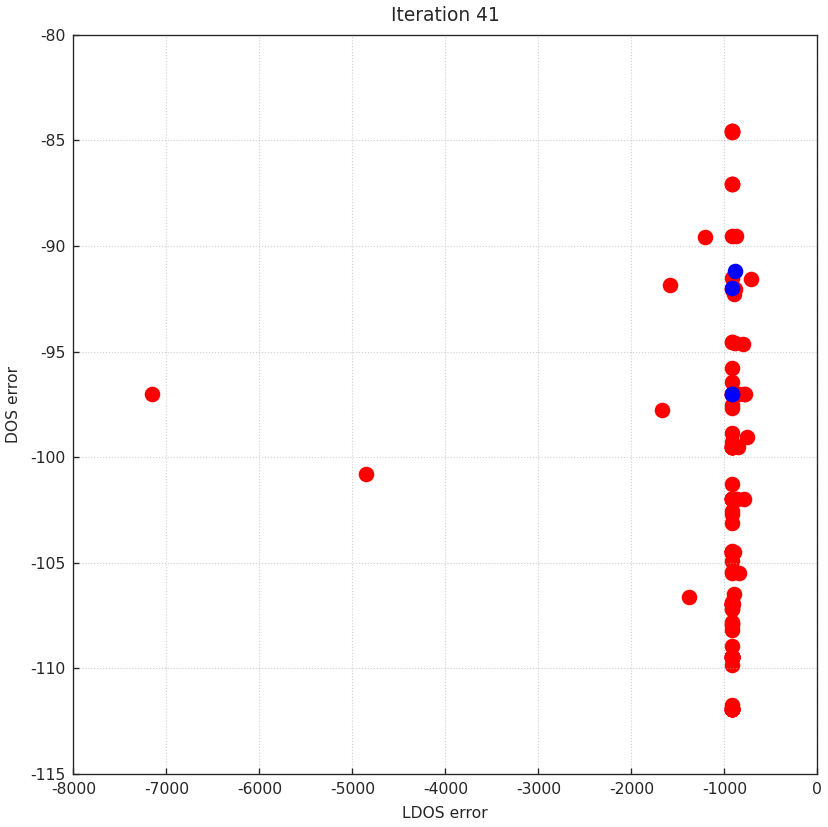


Batch 41: Hypervolume (qEHVI) = (111863.00) time = 16.66.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R

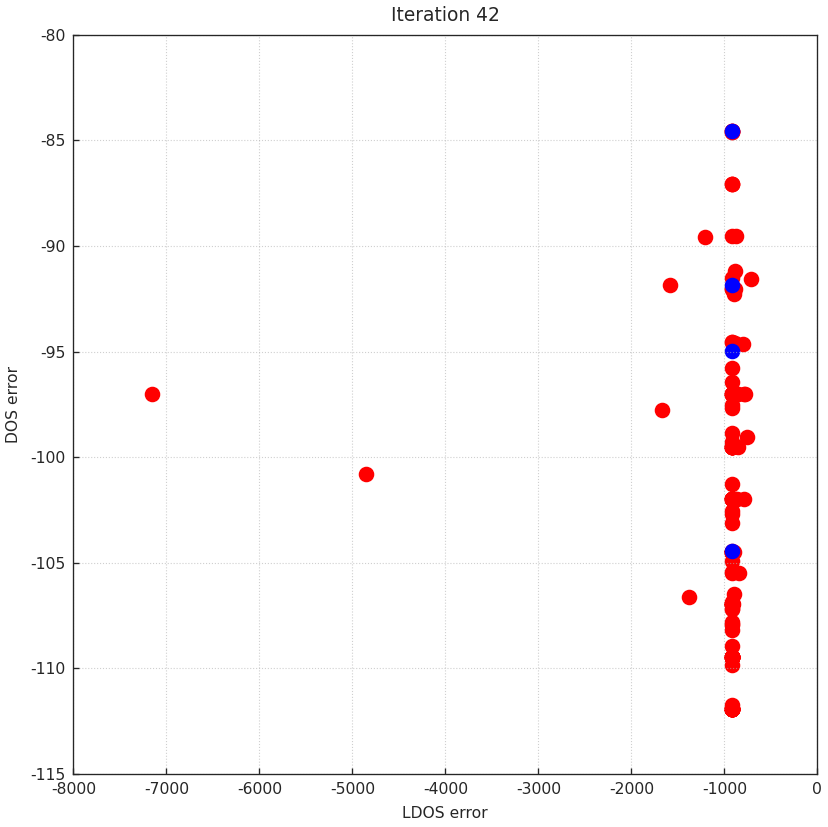


Batch 42: Hypervolume (qEHVI) = (111863.00) time = 18.05.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R

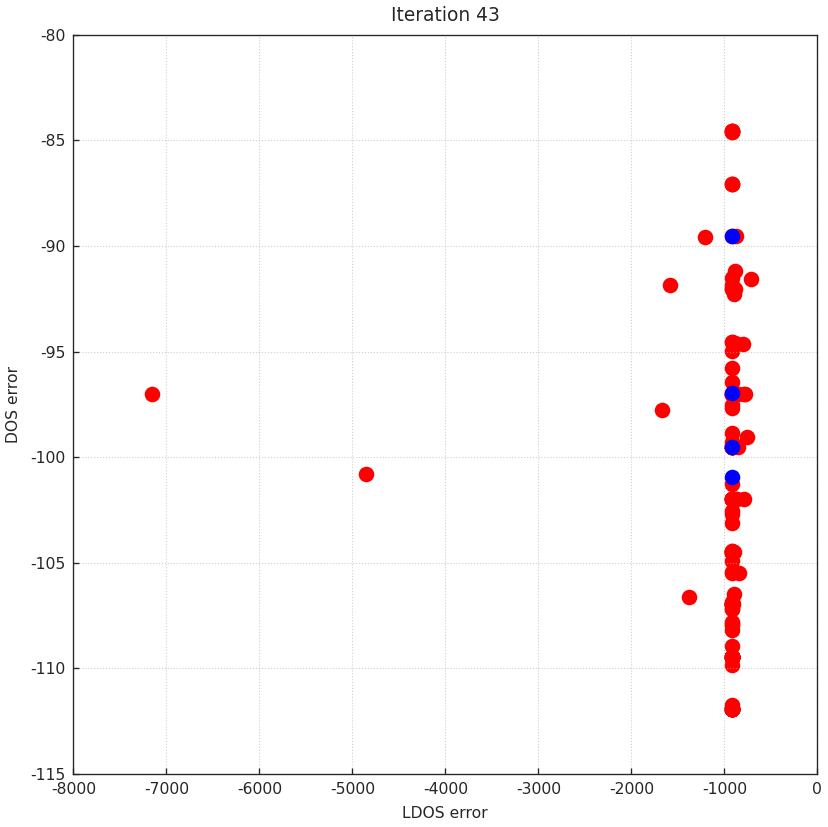


Batch 43: Hypervolume (qEHVI) = (111863.00) time = 26.97.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

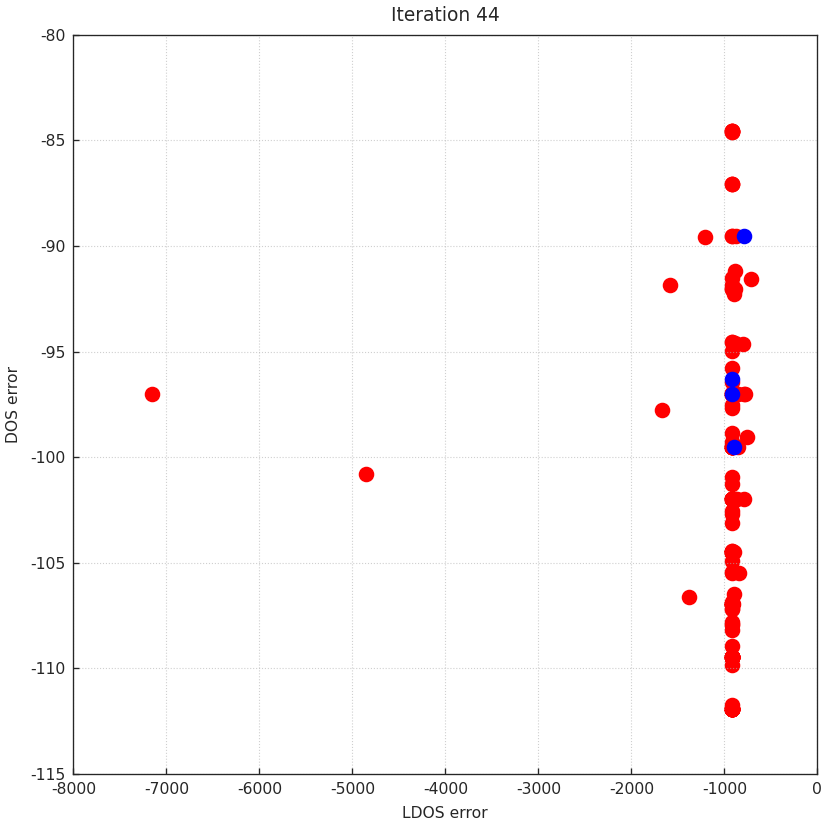


Batch 44: Hypervolume (qEHVI) = (112029.07) time = 24.17.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R)

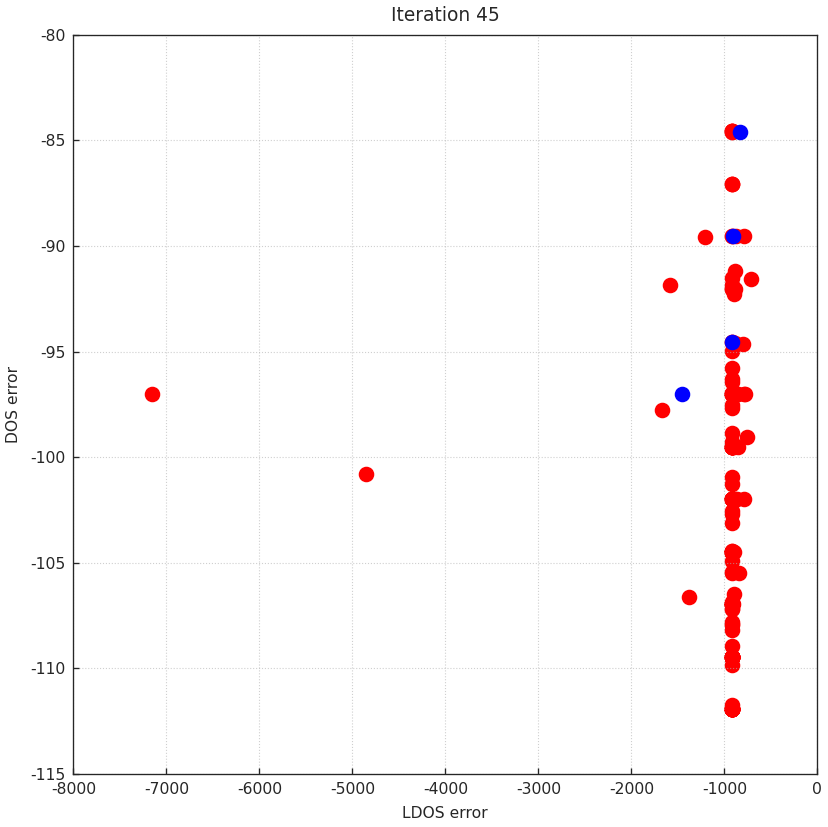


Batch 45: Hypervolume (qEHVI) = (112424.69) time = 22.33.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

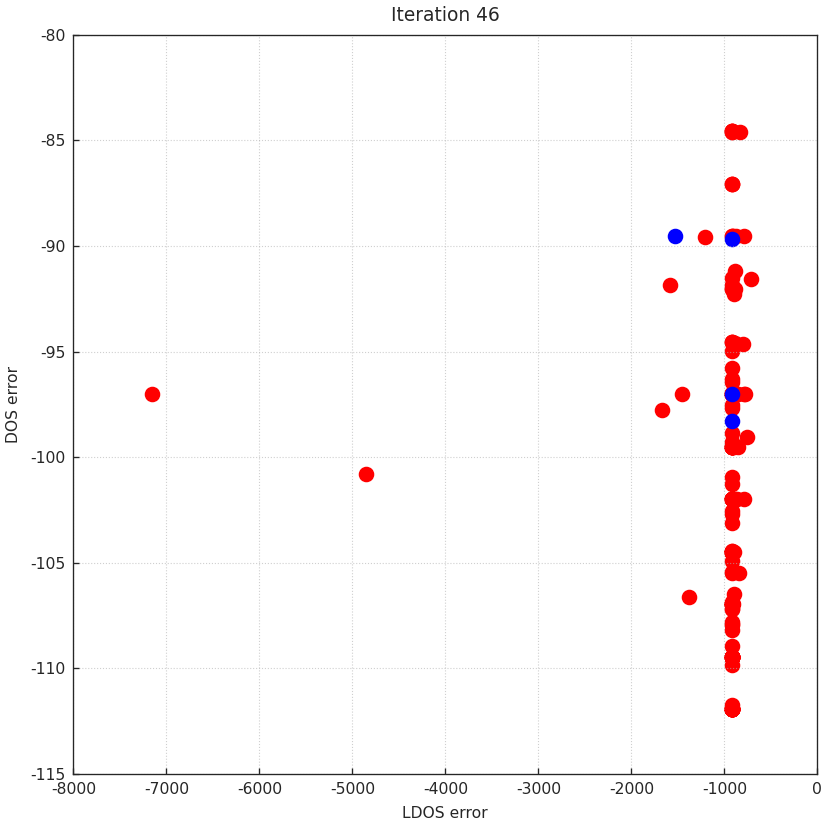


Batch 46: Hypervolume (qEHVI) = (112424.69) time = 25.15.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

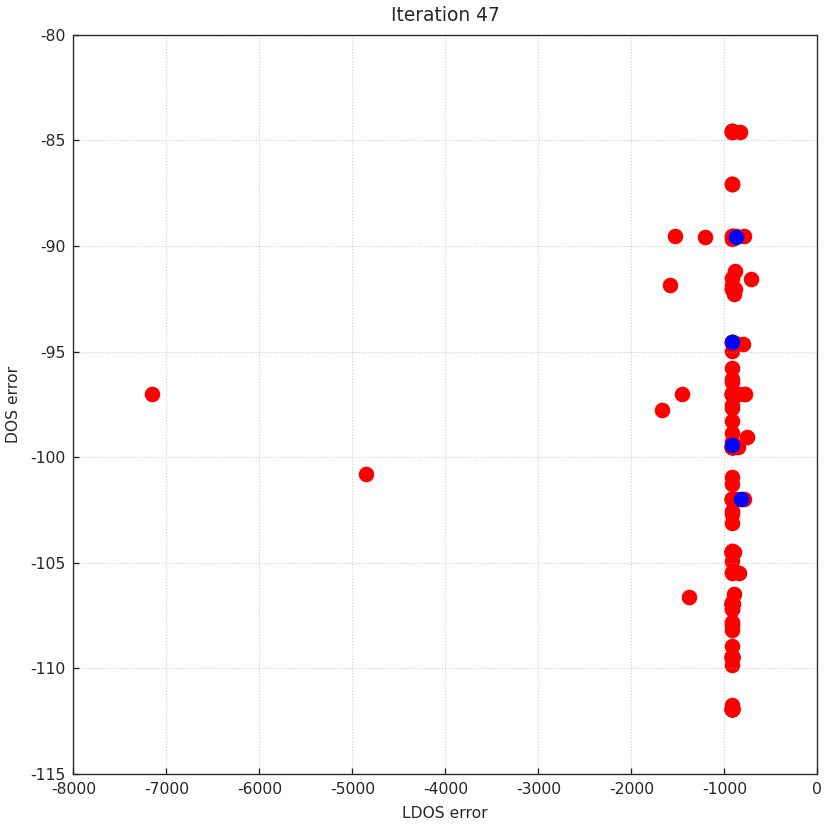


Batch 47: Hypervolume (qEHVI) = (112424.69) time = 27.84.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

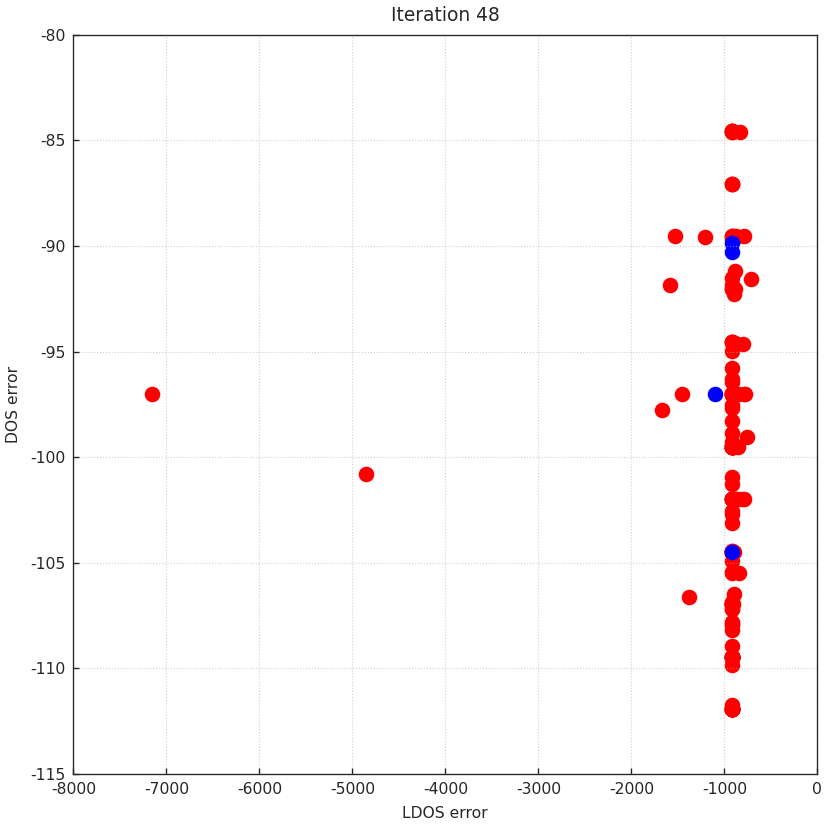


Batch 48: Hypervolume (qEHVI) = (112424.69) time = 29.86.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

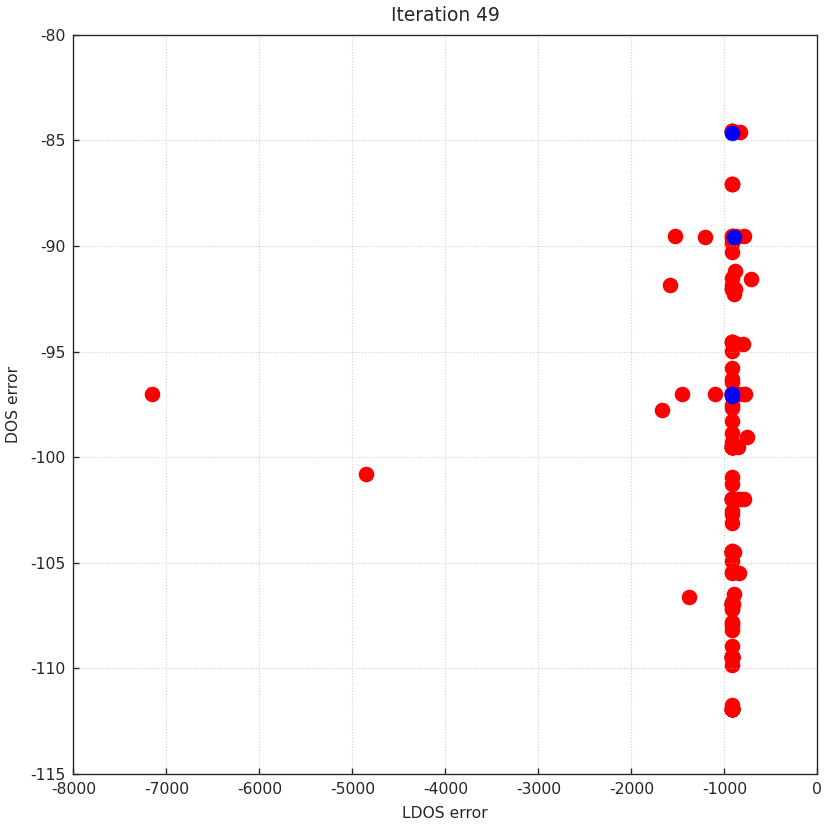


Batch 49: Hypervolume (qEHVI) = (112424.69) time = 25.63.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) A

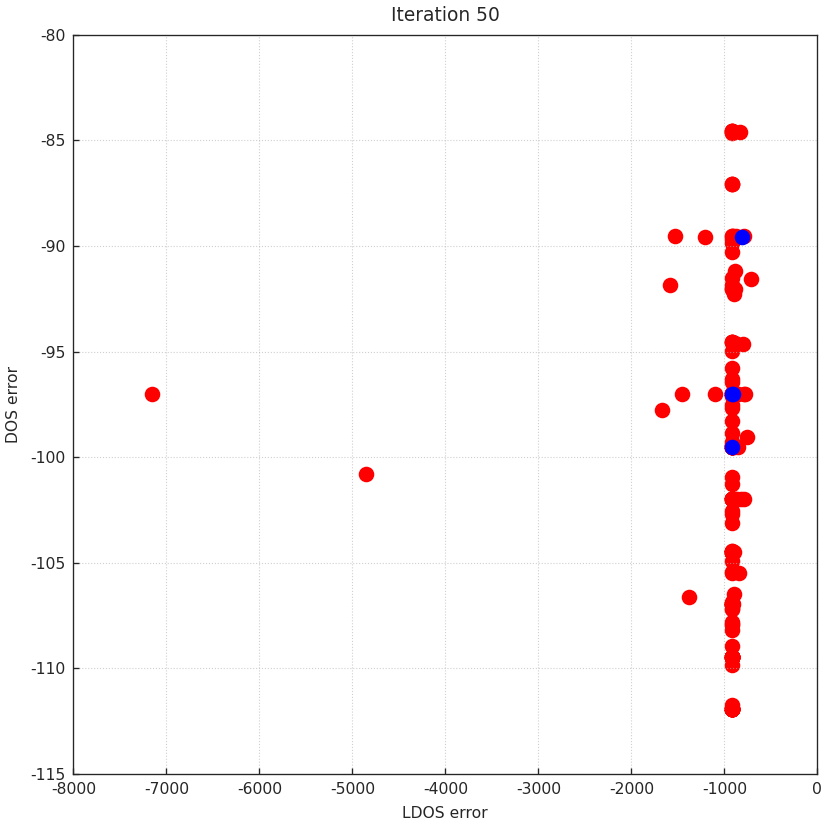


Batch 50: Hypervolume (qEHVI) = (112424.69) time = 25.69.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R)

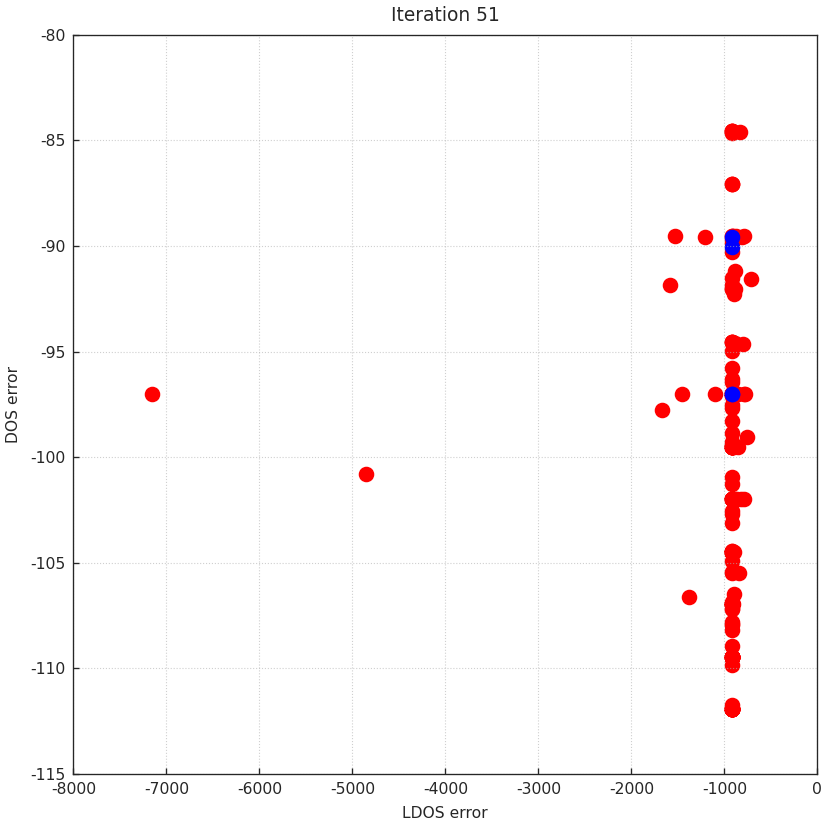


Batch 51: Hypervolume (qEHVI) = (112424.69) time = 24.09.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

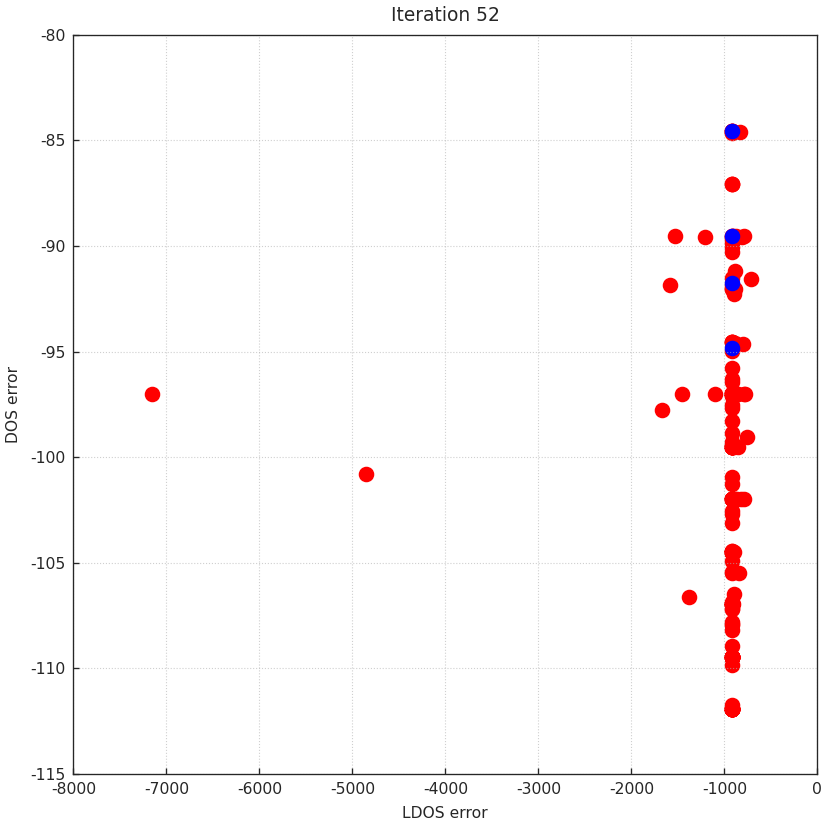


Batch 52: Hypervolume (qEHVI) = (112424.69) time = 28.59.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R

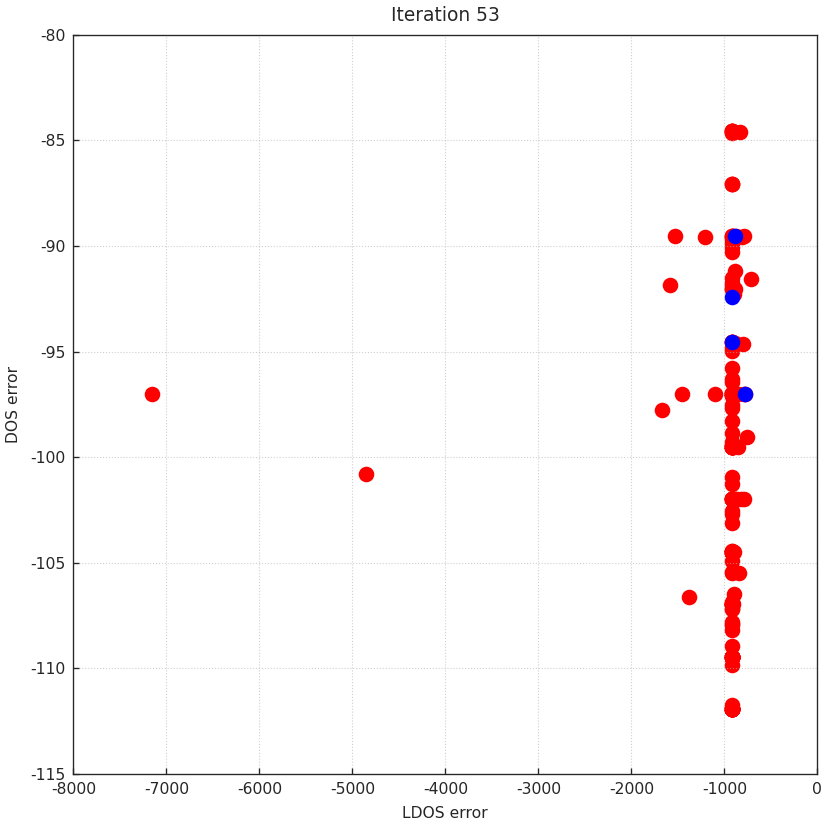


Batch 53: Hypervolume (qEHVI) = (112424.69) time = 26.97.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R

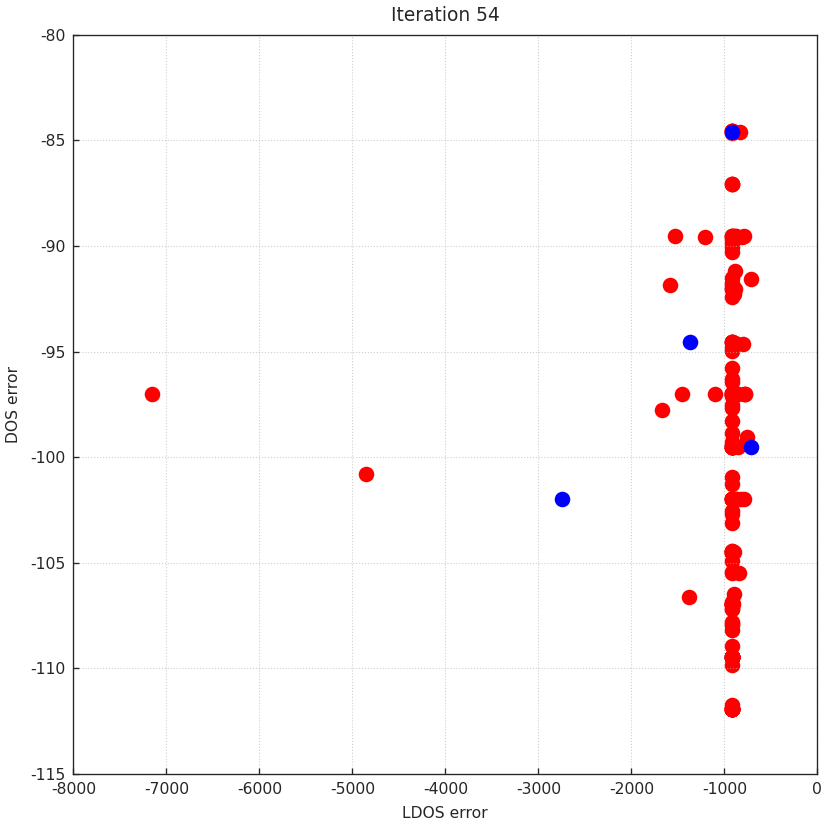


Batch 54: Hypervolume (qEHVI) = (112466.00) time = 27.32.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

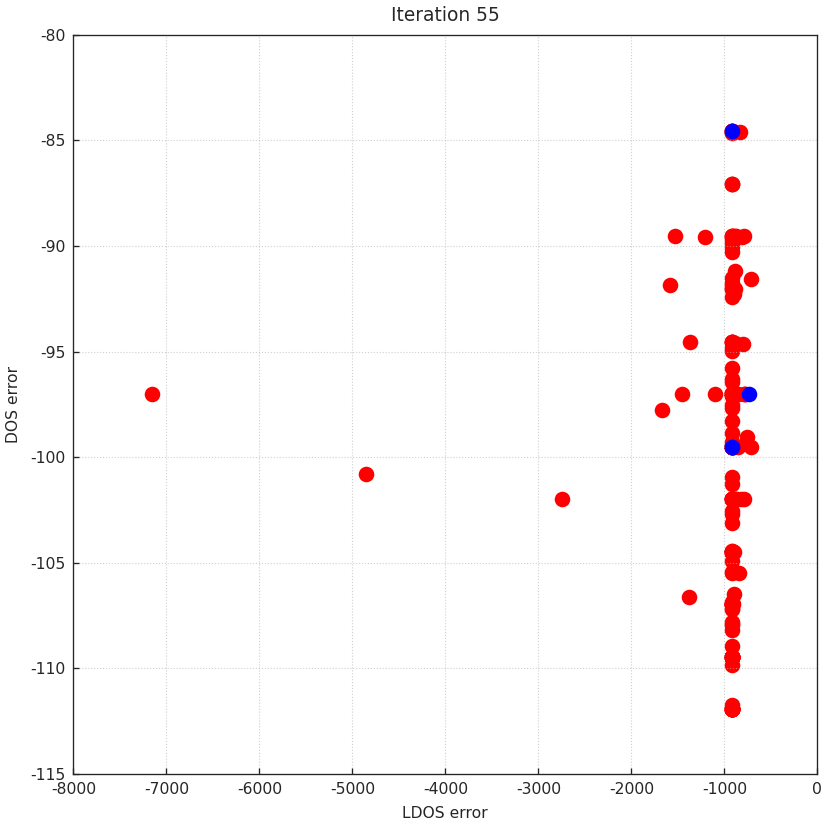


Batch 55: Hypervolume (qEHVI) = (112466.00) time = 28.71.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

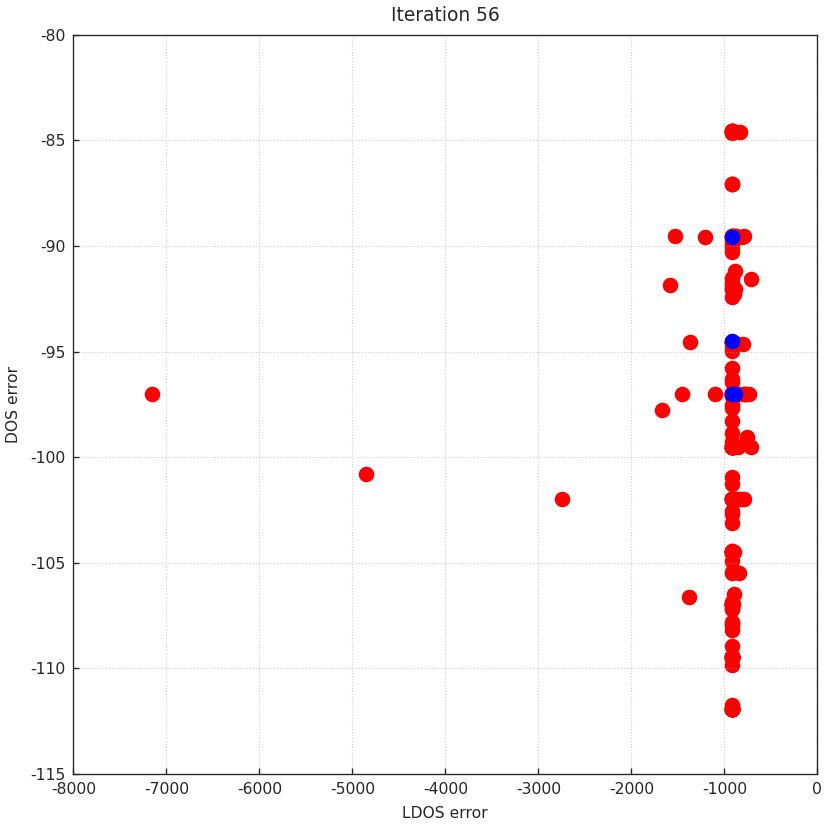


Batch 56: Hypervolume (qEHVI) = (112466.00) time = 27.63.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

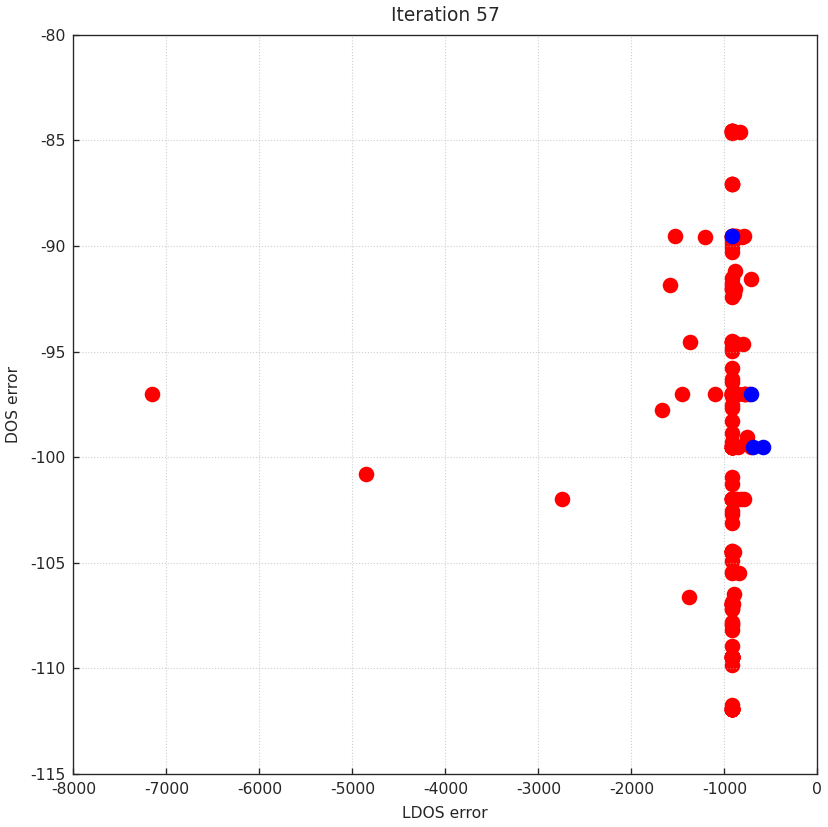


Batch 57: Hypervolume (qEHVI) = (114057.69) time = 25.11.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) A

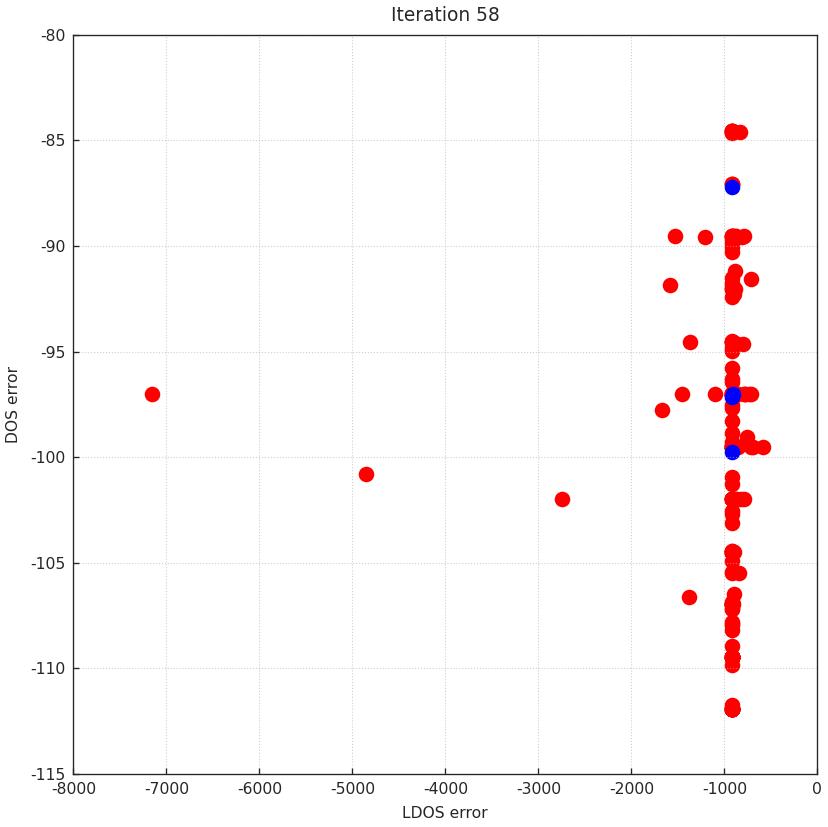


Batch 58: Hypervolume (qEHVI) = (114057.69) time = 27.86.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

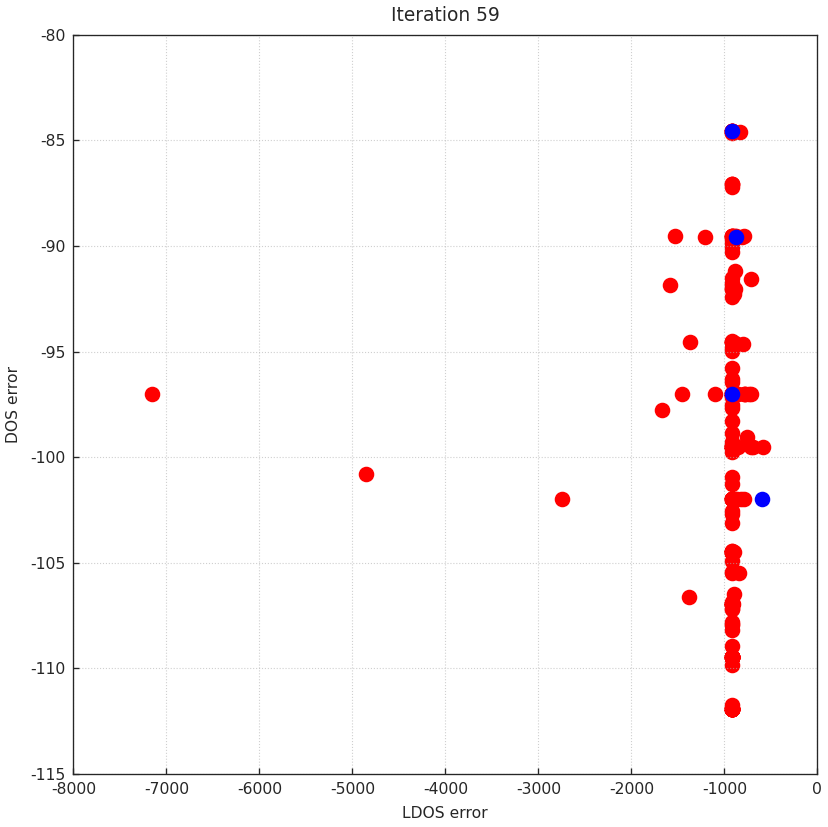


Batch 59: Hypervolume (qEHVI) = (114057.69) time = 29.30.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

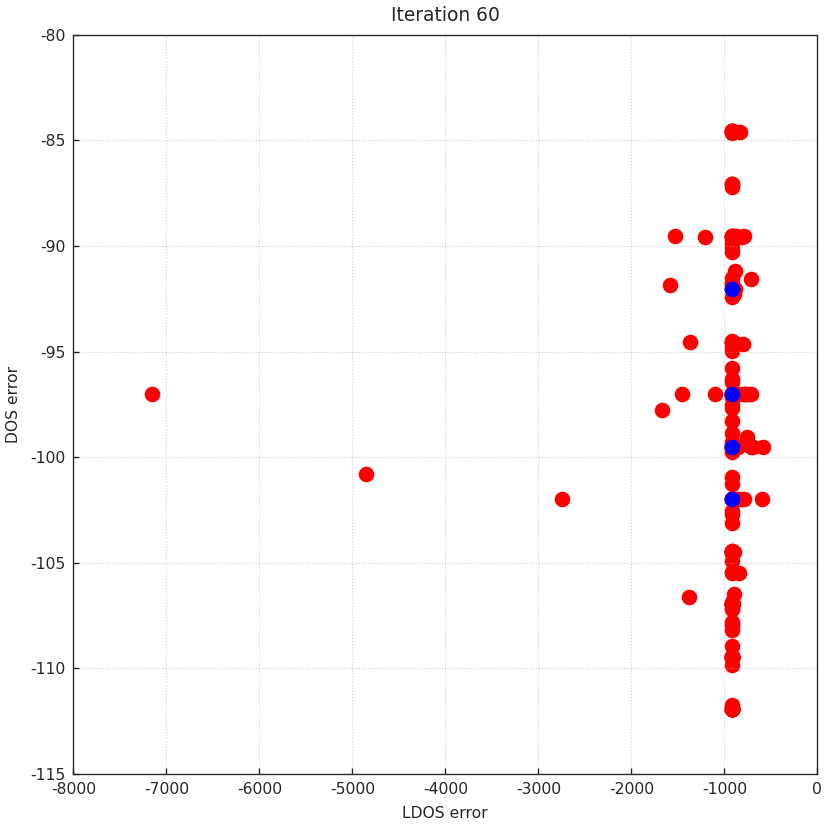


Batch 60: Hypervolume (qEHVI) = (114057.69) time = 31.56.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

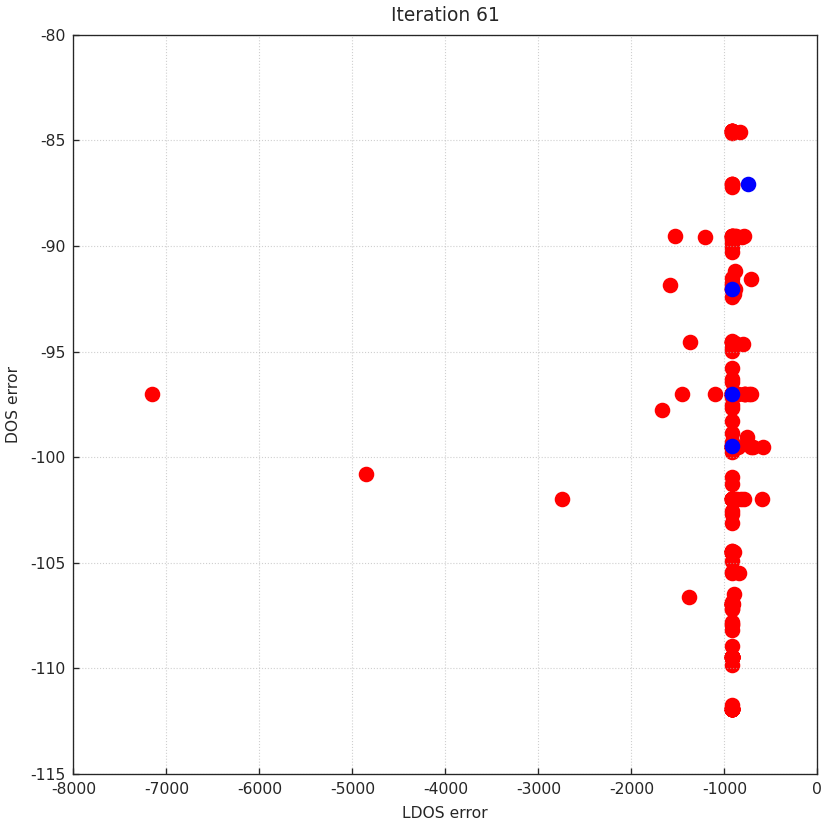


Batch 61: Hypervolume (qEHVI) = (114361.58) time = 39.26.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) 

In [206]:
import time
import warnings

from botorch import fit_gpytorch_mll
from botorch.exceptions import BadInitialCandidatesWarning
from botorch.sampling.normal import SobolQMCNormalSampler
from botorch.utils.multi_objective.box_decompositions.dominated import (
    DominatedPartitioning,
)
from botorch.utils.multi_objective.pareto import is_non_dominated

warnings.filterwarnings('ignore', category=BadInitialCandidatesWarning)
warnings.filterwarnings('ignore', category=RuntimeWarning)

N_BATCH = 100 if not SMOKE_TEST else 5
MC_SAMPLES = 128 if not SMOKE_TEST else 16

verbose = True

hvs_qehvi = []

# Generate initial data

train_x_qehvi, train_obj_qehvi = generate_initial_data(n=2*(dimension+1))
mll_qehvi, model_qehvi = initialize_model(train_x_qehvi, train_obj_qehvi)

# defining the refence point
if reference_point is None:
    reference_point = train_obj_qehvi.min(dim=0).values


# compute hypervolume
bd = DominatedPartitioning(ref_point=reference_point, Y=train_obj_qehvi)
volume = bd.compute_hypervolume().item()
hvs_qehvi.append(volume)

# run N_BATCH rounds of BayesOpt after the initial random batch

for iteration in range(1, N_BATCH+1):
    t0 = time.monotonic()

    # fit the model
    fit_gpytorch_mll(mll_qehvi)

    # define sampler
    qehvi_sampler = SobolQMCNormalSampler(sample_shape=torch.Size([MC_SAMPLES]))

    #optimize acquisition function to get new observations
    new_x_qehvi, new_obj_qehvi = optimize_qehvi_and_get_observation(model_qehvi, train_x_qehvi, train_obj_qehvi, qehvi_sampler)
    print(f"\nNext Point: {new_x_qehvi}")
    print(f"\nNext Objective: {new_obj_qehvi}")

    plot_train_obj(train_obj_qehvi, new_obj_qehvi, iteration)
    # update the training data

    train_x_qehvi = torch.cat([train_x_qehvi, new_x_qehvi])
    train_obj_qehvi = torch.cat([train_obj_qehvi, new_obj_qehvi])

    # update progress
    for hvs_list, train_obj in zip((hvs_qehvi,), (train_obj_qehvi,)):
        # compute hypervolume
        bd = DominatedPartitioning(ref_point=reference_point, Y=train_obj)
        volume = bd.compute_hypervolume().item()
        hvs_list.append(volume)

    # reinitialize the models so they are ready for fitting on next iteration
    # Note: we find improved performance from not warm starting the model hyperparameters
    # using the hyperparameters from the previous iteration

    mll_qehvi, model_qehvi = initialize_model(train_x_qehvi, train_obj_qehvi)

    t1 = time.monotonic()

    if verbose:
        print(f"\nBatch {iteration:>2}: Hypervolume (qEHVI) = "
              f"({hvs_qehvi[-1]:>4.2f}) "
              f"time = {t1-t0:>4.2f}.",
              end="",)
    else:
        print(".", end="")
    





In [ ]:
# #model = pb.Model(Kagome_lattice(d=0.133,t_a=0.0285,t_b=0.075), pb.translational_symmetry(a1=True,a2=True), shape)
# model = pb.Model(Kagome_lattice(d=0.133,t_a=0.0285,t_b=0.075), shape)
# model.plot()
# shape.plot()
# #model = pb.Model(Kagome_lattice(d=0.133), pb.primitive(a1=4,a2=4))

# #model.plot()


In [ ]:
# solver = pb.solver.lapack(model)
# d=0.133
# #a=sqrt(3)*d
# a=2*d
# Gamma = [0, 0]

# # K1 = [0, -4*pi / (3*sqrt(3)*d),]
# # M = [2*pi / (3*d),0]
# # K2 = [2*pi / (3*d),2*pi   / (3*sqrt(3)*d)]

# K1 = [0, -4*pi / (3*a),]
# M = [2*pi / (sqrt(3)*a),0]
# K2 = [2*pi / (sqrt(3)*a),2*pi / (3*a)]

# # K1 = [0, -4*pi / (2*sqrt(3)*a),]
# # M = [2*pi / (2*a),0]
# # K2 = [2*pi / (2*a),2*pi / (2*sqrt(3)*a)]

# bands = solver.calc_bands(K1,Gamma, M, K2)
# bands.plot(point_labels=['K',r'$\Gamma$', 'M','K'])

# plt.show()

In [ ]:
# energy=-0.08
# plt.title("E = {} eV".format(energy))

# #solver = pb.solver.arpack(model, k=3, sigma=energy)
# solver= pb.solver.lapack(model)
# ldos_map = solver.calc_spatial_ldos(energy=energy, broadening=0.003)
# ldos_map.plot()
# pb.pltutils.colorbar(label="LDOS")

In [ ]:
# dos = solver.calc_dos(energies=np.linspace(-0.15, 0.25, 200), broadening=0.003)    # broadening is the smoothing parameter
# dos.plot()

Define the problem, modify the objective function, include L1 and L2 norm in it. 